<a href="https://colab.research.google.com/github/nicolecosta/visaocomputacional/blob/main/resumao_visao.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **RESUMÃO VISÃO COMPUTACIONAL 2021.2**
NICOLE SARVASI ALVES DA COSTA

## **Importar o móludo cv2 e o módulo matplotlib**

In [ ]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

### **Aquisição de imagem ou vídeo**

In [ ]:
from google.colab import files
uploaded=files.upload()

Saving lena.jpg to lena.jpg


### **Fazer leitura da imagem**

In [50]:
img = cv2.imread('lena.jpg')

### **Passar para níveis de cinza**

In [51]:
gray_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

Exemplo: converter imagem para binária e armazenar numa nova variável e fazer sua exibição

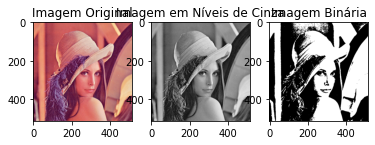

In [ ]:
#Referência: https://docs.opencv.org/4.5.2/d6/d00/tutorial_py_root.

ret,img_th = cv2.threshold(gray_img,127,255,cv2.THRESH_BINARY)

fig,ax=plt.subplots(ncols=3)
ax[0].imshow(img[...,::-1])  #BGR para RGB
ax[0].set_title('Imagem Original')
ax[1].imshow(gray_img,cmap=plt.cm.gray)
ax[1].set_title('Imagem em Níveis de Cinza')
ax[2].imshow(img_th,cmap=plt.cm.gray)
ax[2].set_title('Imagem Binária')
plt.show()

## **LEITURA DE IMAGEM**

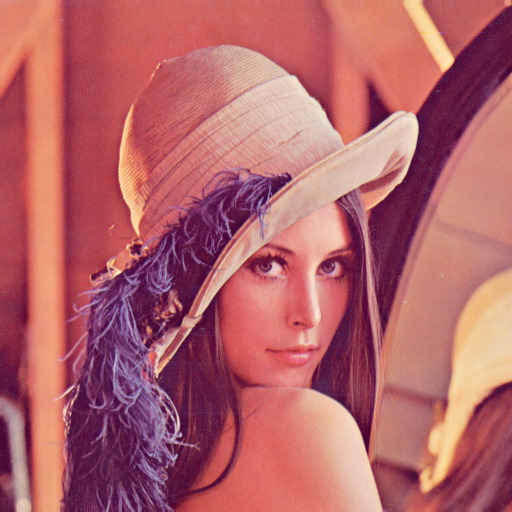

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys #eventualmente colocar alguma mensagem

#testar se está lendo imagem
img = cv.imread("lena.jpg") #leitura

#processamento
if img is None:
  sys.exit("Could not read the image.")

cv2_imshow(img) #"printar" imagem

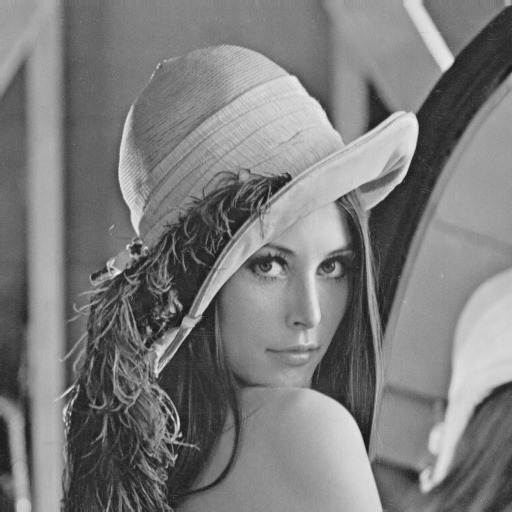

True

In [ ]:
#trasformar imagem de BGR para nível de cinza
gray_img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray_img)

#gravar imagem no diretório
cv.imwrite("lena_gra.png", gray_img)

## **LEITURA DE VÍDEO**

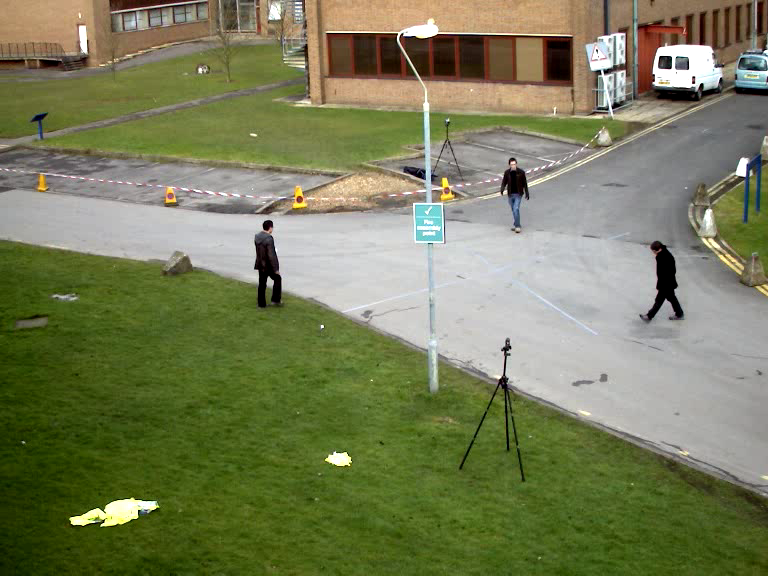

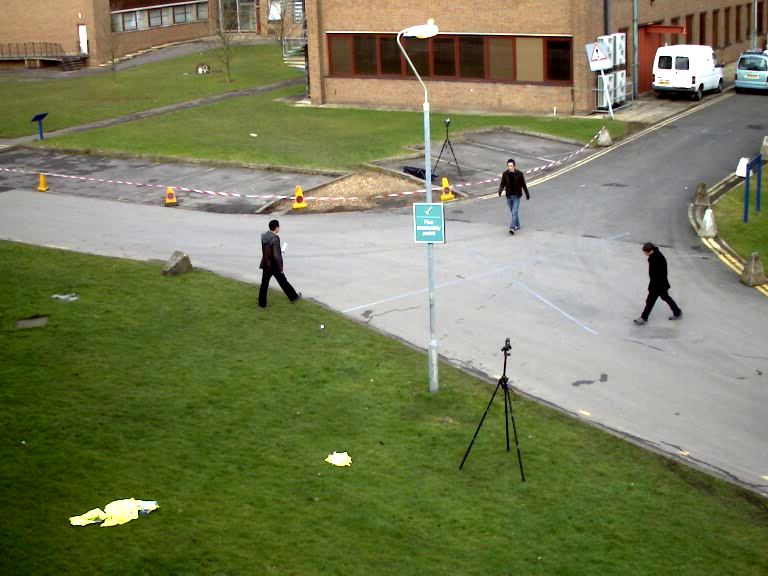

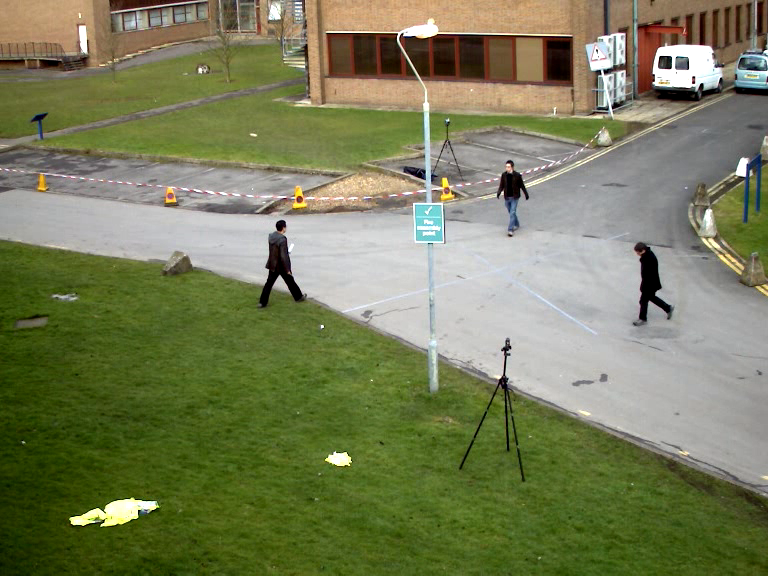

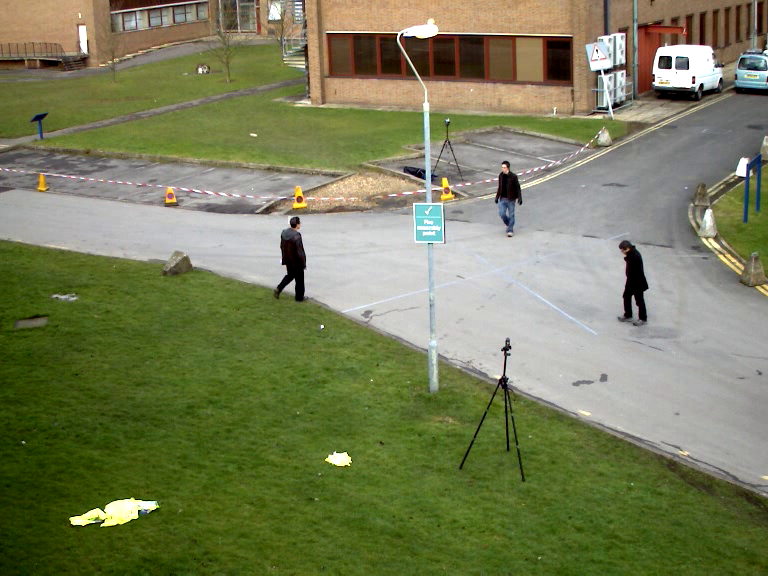

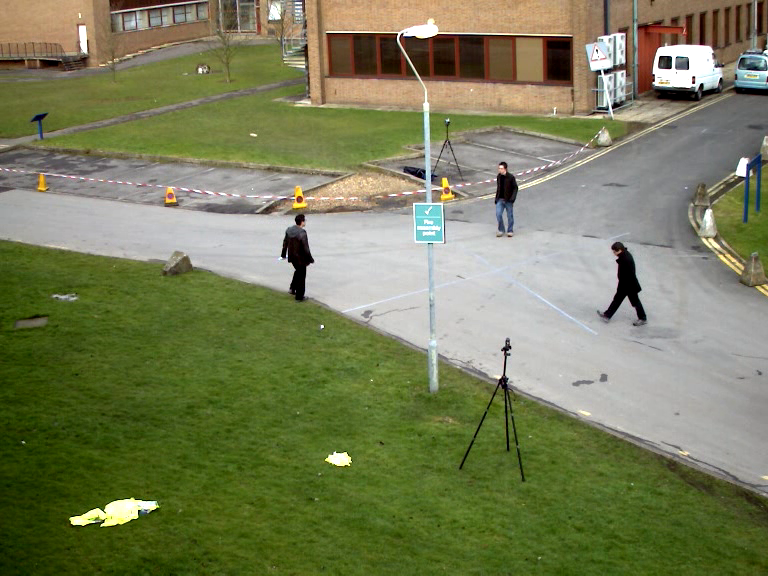

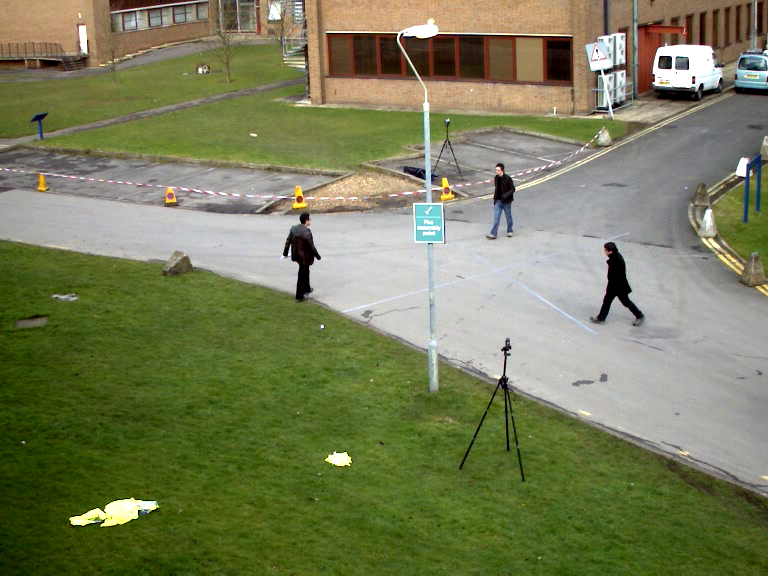

In [ ]:
import numpy as np
import cv2 as cv2
from google.colab.patches import cv2_imshow
import sys

#pegar vídeo
cap = cv.VideoCapture('video.avi')

#mostrar os primeiros 5 frames
for i in range(6):
#se quiser mostrar todos os frames do vídeo, basta usar o loop comentado abaixo
#wile cap.isOpened():
  ret, frame = cap.read()  #exibir o vídeo

  #if frame is read correctly ret is True
  if not ret:
    print("Can't receive frame (stream end?). Exiting...")
    break
  cv2_imshow(frame)

cap.release() #liberar memória

## **LEITURA DE IMAGENS A PARTIR DE UMA CÂMERA**

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      //pedir acesso à câmera
      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


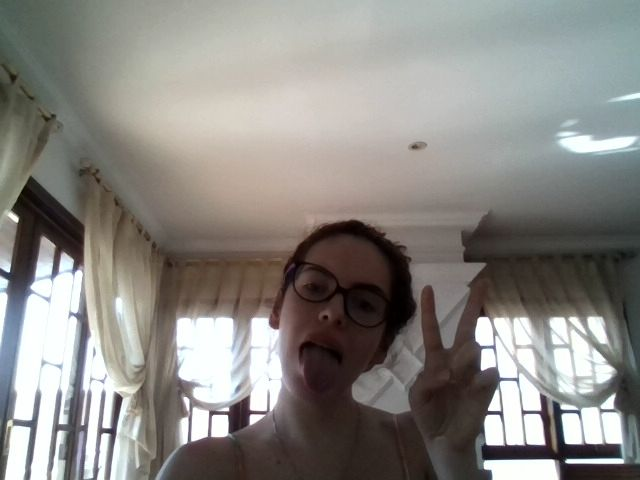

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

EXEMPLO: capturar X frames da câmera, converte-los para níveis de cinza e salvar em arquivos separados

<IPython.core.display.Javascript object>

Saved to eu#0.jpg


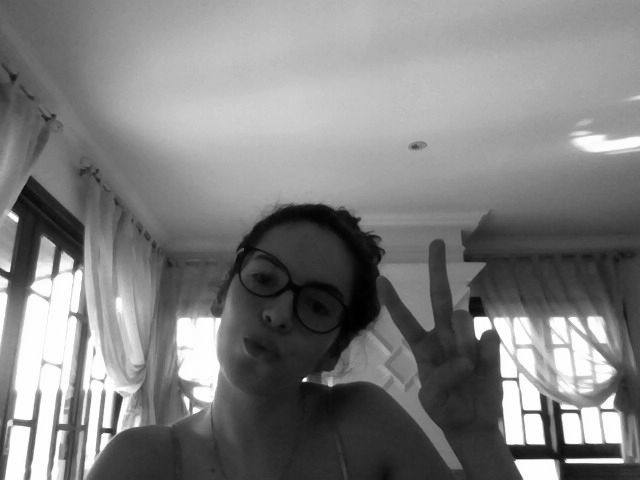

In [ ]:
from IPython.display import Image
for i in range(1):
  try:
    #outra solução: filename = take_photo(filename='eu#'+str(i)+'.jpg')
    filename = take_photo(filename='eu#{}.jpg'.format(i))
    print('Saved to {}'.format(filename))
    img = cv.imread(filename)
    cv.imwrite(filename,cv.cvtColor(img,cv.COLOR_BGR2GRAY))
    # Show the image which was just taken.
    display(Image(filename))
  except Exception as err:
    # Errors will be thrown if the user does not have a webcam or if they do not
    # grant the page permission to access it.
    print(str(err))

## **PROPRIEDADES DE IMAGENS**

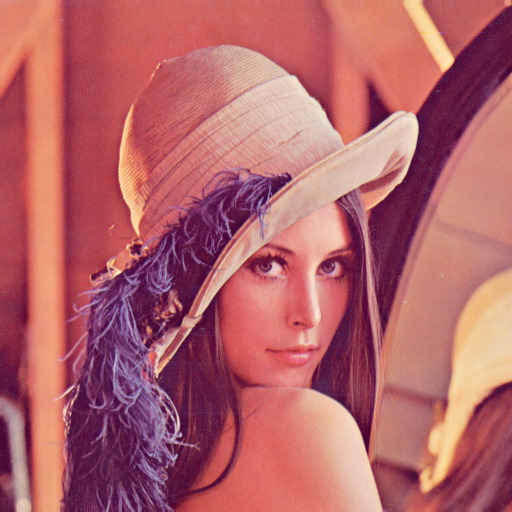

(512, 512, 3)
786432 pixels
uint8


In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img = cv.imread("lena.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)

#It returns a tuple of the number of rows, columns, and channels (if the image is color)
print( img.shape )

print(img.size,"pixels")  #número total de pixels

print(img.dtype)  #tipo de dado usado na representação de cor de cada pixel

## **ACESSO AOS PIXELS DA IMAGEM**

Usamos uma linha e uma coluna (o canto superior esquerdo é a origem da imagem [0,0]). Se a imagem for colorida (3 canais), o resultado mostra o valor dos canais B, G e R.


In [ ]:
#alterar valor de pixel -> indicar valor da coordenada (linha,coluna) e atribuir os valores dos canais 
img[100,100] = [255,255,255]
print( img[100,100] )

[255 255 255]


EXEMPLO: convertendo a imagem em níveis de cinza para imagem binária utilizando as operações de manipulação de pixel.

Se os canais não aparecem, supomos que temos apenas 1 canal de cor.

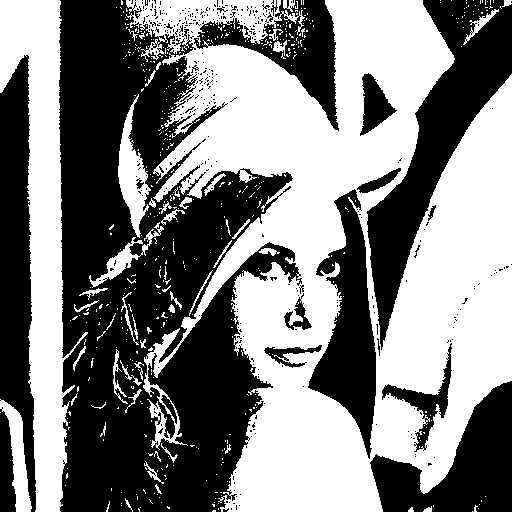

In [ ]:
import numpy as np

lin,col = gray_img.shape
T = np.median(gray_img) #mediana

for l in range(lin):
  for c in range(col):
    if gray_img[l,c]<T:
      gray_img[l,c]=0
    else:
      gray_img[l,c]=255

cv2_imshow(gray_img)

## **REGION OF INTEREST (ROI)**

Algumas vezes estamos interessados em trabalhar apensa com uma determinada região da imagem. Para definir uma ROI, definimos um slice na matriz que representa internamente a imagem.

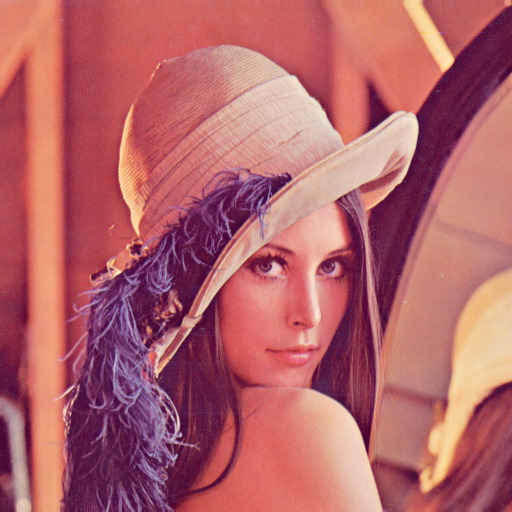

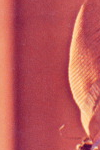

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img = cv.imread("lena.jpg")

if img is None:
  sys.exit("Could not read the image.")

cv2_imshow(img)
roi = img[100:250,50:150]
cv2_imshow(roi)

EXEMPLO: definir uma ROI qualquer e copiá-la para um outro lugar na imagem.

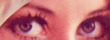

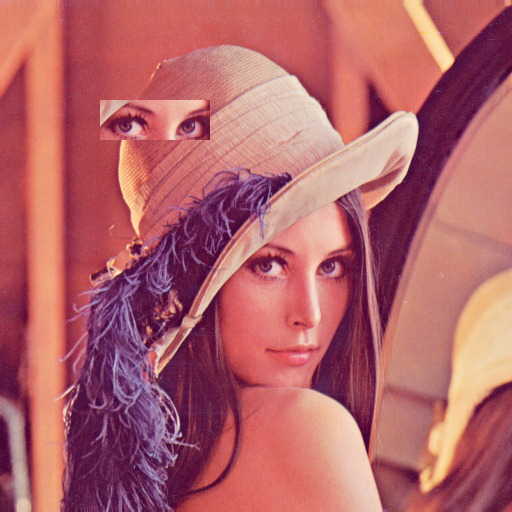

In [ ]:
roi3 = img[240:280,240:350]
cv2_imshow(roi3)
img2 = img.copy()
img2[100:140,100:210] = roi3
cv2_imshow(img2)

## **DECOMPOSIÇÃO E JUNÇÃO DE CANAIS DE COR**

A separação (split) e junção (merge) de canais é feita como abaixo.

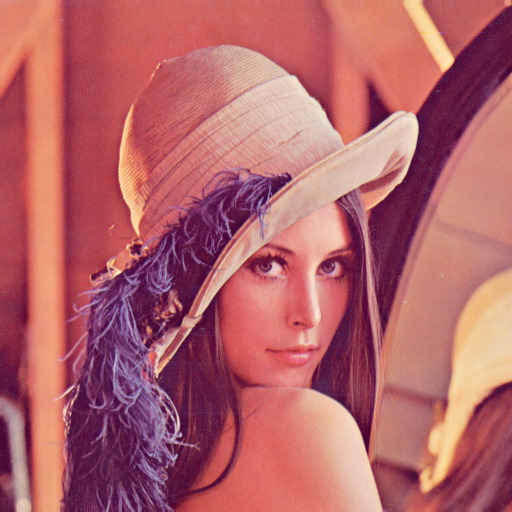

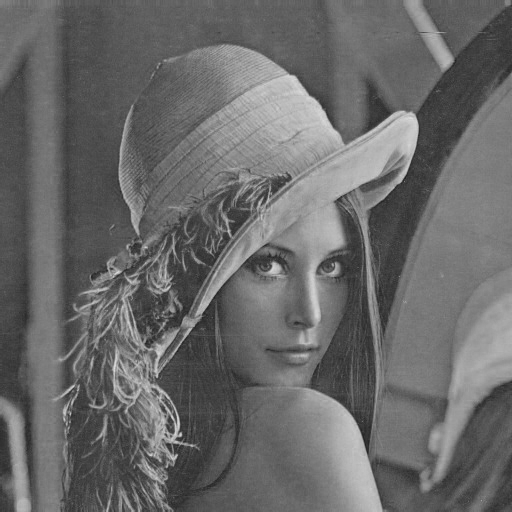

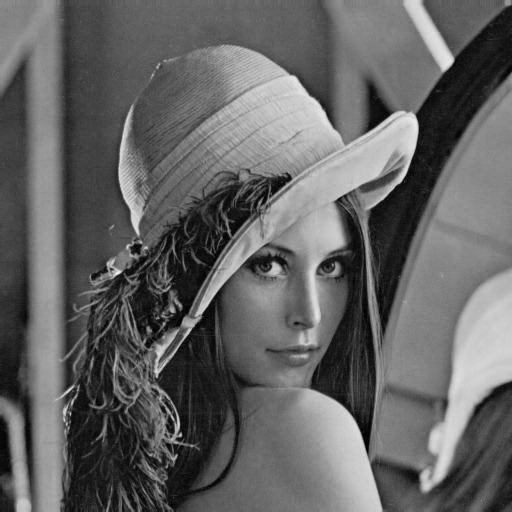

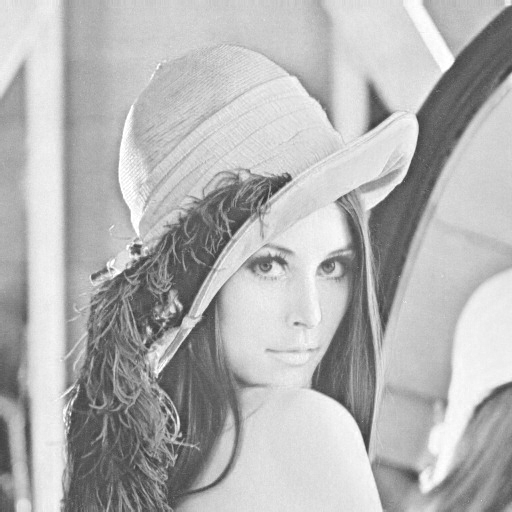

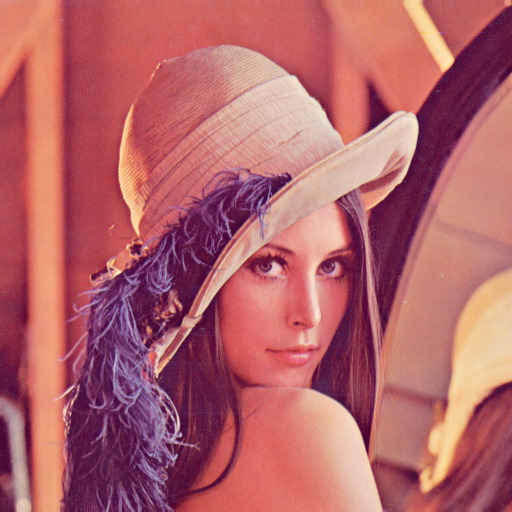

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img = cv.imread("lena.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)

b,g,r = cv.split(img)  #separação em bgr
cv2_imshow(b)
cv2_imshow(g)
cv2_imshow(r)

img = cv.merge((b,g,r))  #junção

cv2_imshow(img)

EXEMPLO: pegar uma imagem em níveis de cinza e colorizá-la artificialmente, gerando uma imagem com 3 canais de cor (B,G,R).

## **ESPAÇO DE CORES BGR/RGB**
# Nova seção
A mudança do espaço de cor de uma imagem pode ser realizada pela chamada da função cv.cvtColor(imagem,flag)

In [1]:
#modos de conversão
import cv2 as cv 
flags = [i for i in dir(cv) if i.startswith('COLOR_')] 
for c in range(len(flags)):
  print(flags[c])

COLOR_BAYER_BG2BGR
COLOR_BAYER_BG2BGRA
COLOR_BAYER_BG2BGR_EA
COLOR_BAYER_BG2BGR_VNG
COLOR_BAYER_BG2GRAY
COLOR_BAYER_BG2RGB
COLOR_BAYER_BG2RGBA
COLOR_BAYER_BG2RGB_EA
COLOR_BAYER_BG2RGB_VNG
COLOR_BAYER_GB2BGR
COLOR_BAYER_GB2BGRA
COLOR_BAYER_GB2BGR_EA
COLOR_BAYER_GB2BGR_VNG
COLOR_BAYER_GB2GRAY
COLOR_BAYER_GB2RGB
COLOR_BAYER_GB2RGBA
COLOR_BAYER_GB2RGB_EA
COLOR_BAYER_GB2RGB_VNG
COLOR_BAYER_GR2BGR
COLOR_BAYER_GR2BGRA
COLOR_BAYER_GR2BGR_EA
COLOR_BAYER_GR2BGR_VNG
COLOR_BAYER_GR2GRAY
COLOR_BAYER_GR2RGB
COLOR_BAYER_GR2RGBA
COLOR_BAYER_GR2RGB_EA
COLOR_BAYER_GR2RGB_VNG
COLOR_BAYER_RG2BGR
COLOR_BAYER_RG2BGRA
COLOR_BAYER_RG2BGR_EA
COLOR_BAYER_RG2BGR_VNG
COLOR_BAYER_RG2GRAY
COLOR_BAYER_RG2RGB
COLOR_BAYER_RG2RGBA
COLOR_BAYER_RG2RGB_EA
COLOR_BAYER_RG2RGB_VNG
COLOR_BGR2BGR555
COLOR_BGR2BGR565
COLOR_BGR2BGRA
COLOR_BGR2GRAY
COLOR_BGR2HLS
COLOR_BGR2HLS_FULL
COLOR_BGR2HSV
COLOR_BGR2HSV_FULL
COLOR_BGR2LAB
COLOR_BGR2LUV
COLOR_BGR2Lab
COLOR_BGR2Luv
COLOR_BGR2RGB
COLOR_BGR2RGBA
COLOR_BGR2XYZ
COLOR_BGR2YCR_CB
CO

A conversão pode ser feita aplicando-se diretamente a função sobre toda a imagem:

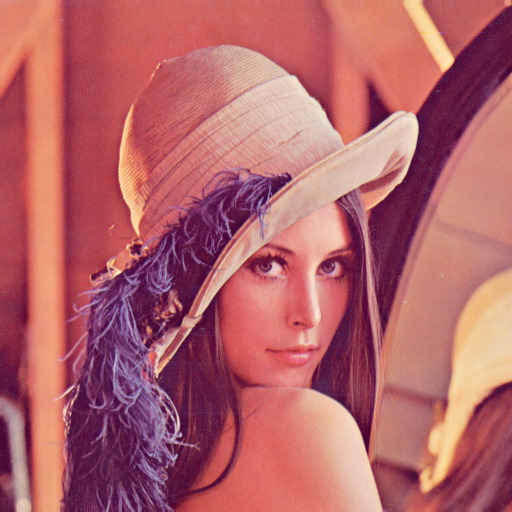

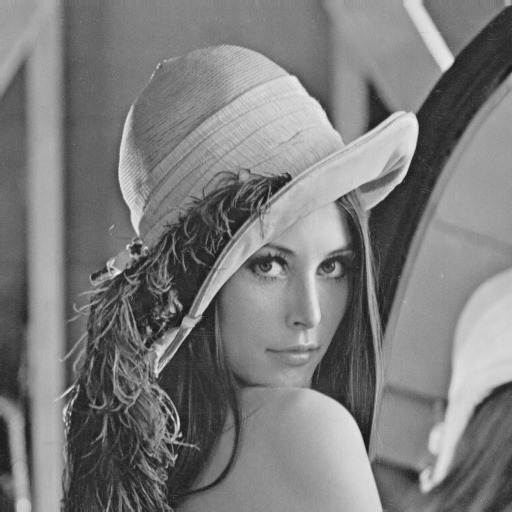

In [5]:
import cv2 as cv2
from google.colab.patches import cv2_imshow
import sys

img = cv.imread("lena.jpg")

if img is None:
    sys.exit("Could not read the image.")

cv2_imshow(img)

im_gray=cv.cvtColor(img,cv.COLOR_BGR2GRAY)
cv2_imshow(im_gray)

A conversão pode ser feita pixel a pixel:

In [6]:
import numpy as np

color = np.uint8([[[0,255,0 ]]])
color_gray = cv.cvtColor(color,cv.COLOR_BGR2GRAY)
print( color_gray)


[[150]]


EX.: Capturar a imagem da lena.jpg (em cores) para níveis de cinza, fazendo o processamento individual de cada pixel.

(512, 512, 3)


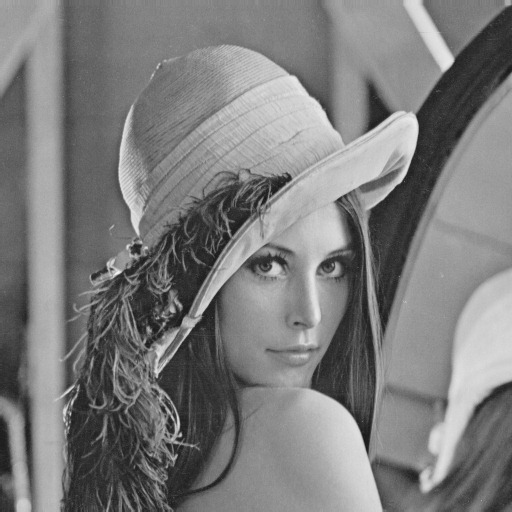

In [7]:
img = cv.imread("lena.jpg")

if img is None:
    sys.exit("Could not read the image.")

rows,cols,channels=img.shape
print(img.shape)

for l in range(rows):
  for c in range(cols):
    img[l,c]=cv.cvtColor(np.uint8([[img[l,c]]]),cv.COLOR_BGR2GRAY)

cv2_imshow(img)

## **ESPAÇOS DE CORES BGR/RGB**

BGR -> [b,g,r]

RGB -> [r,g,b]

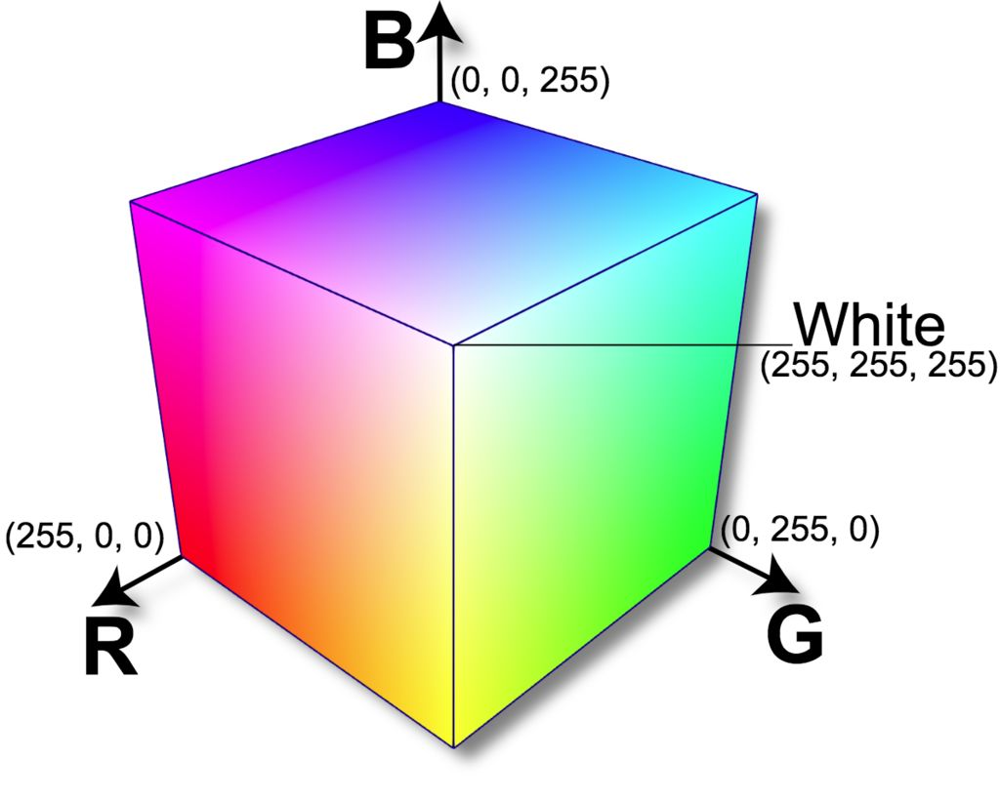

In [8]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img = cv.imread("rgb.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)

### **Teorias da adoção do BGR**

(1) a transferência de cores entre a memória RAM e o conversores RAMDAC das placas VGA mais antigas ficava muito mais eficiente com os bits de cores alinhados na forma BGR. (2) a ordem BGR era o formato mais comum entre os produtos de imagens do início da OpenCV.

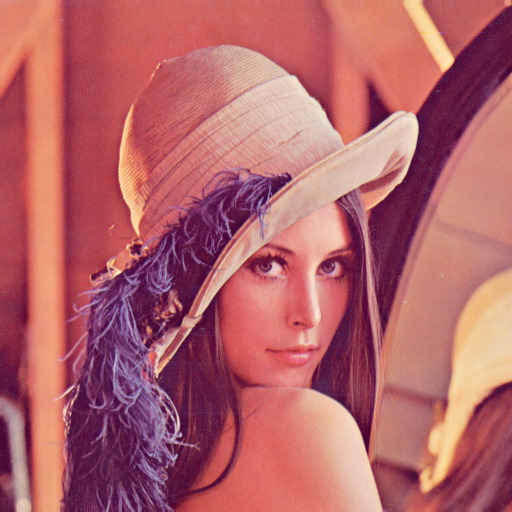

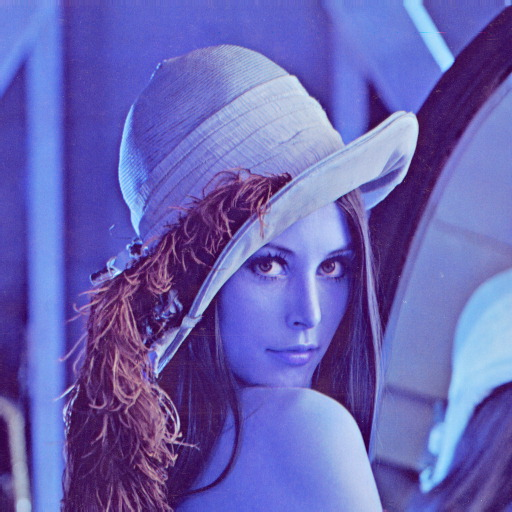

In [9]:

#diferença entre os espaços de cor (BGR e RGB)
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img_bgr = cv.imread("lena.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img_bgr)
img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
cv2_imshow(img_rgb)

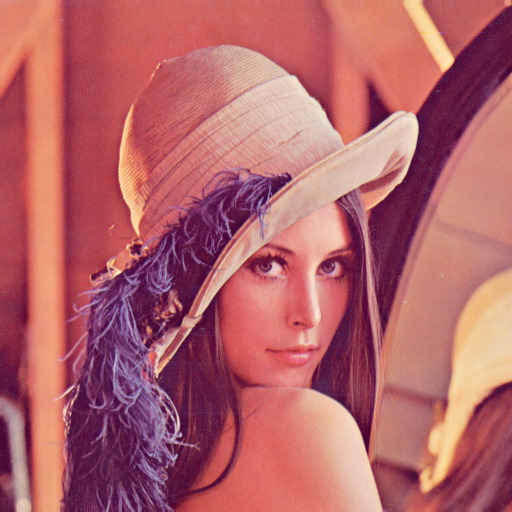

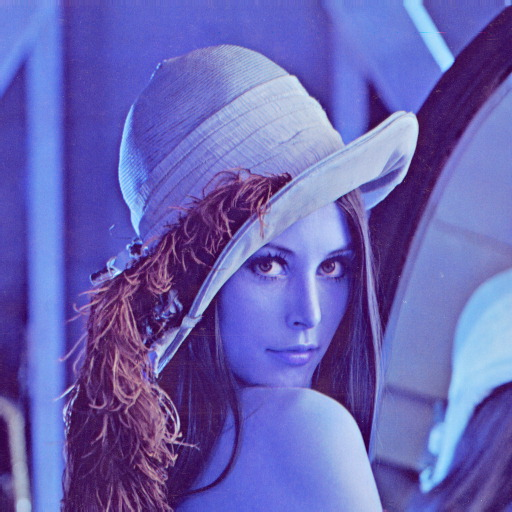

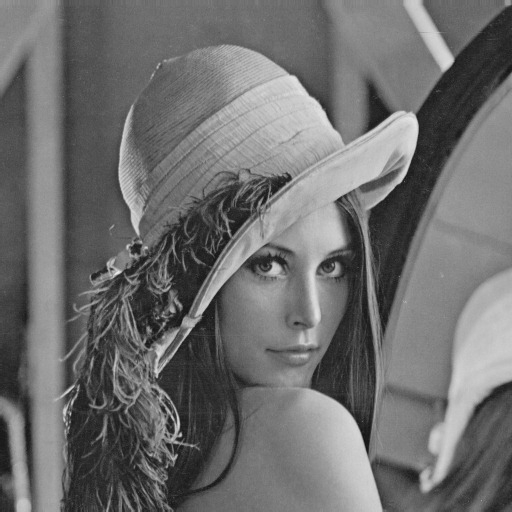

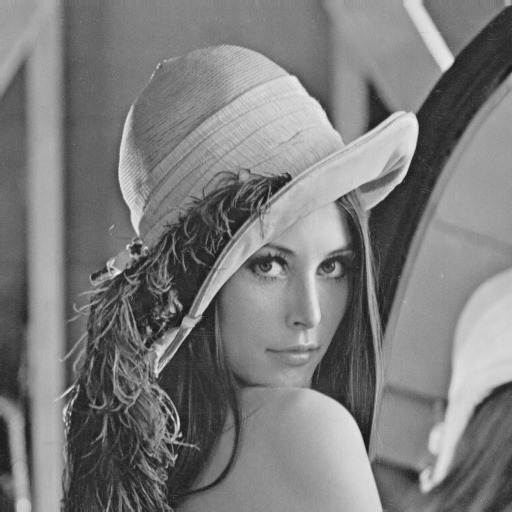

In [10]:
#Convertendo uma imagem de BGR ou RGB para níveis de cinza

import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img_bgr = cv.imread("lena.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img_bgr)
img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
cv2_imshow(img_rgb)

img_grayRGB = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY)
img_grayBGR = cv.cvtColor(img_bgr, cv.COLOR_BGR2GRAY)
cv2_imshow(img_grayRGB)
cv2_imshow(img_grayBGR)


#(R,G,B) --> (c,c,c)     d=sqrt((R-C)^2+(G-C)^2+(B-C)^2)
#Portanto, segundo a equação acima, não ocorre diferença entre as imagens 
#em nível de cinza de uma imagem RGB e uma imagem BGR

## **ESPAÇOS DE CORES HSV**

O espaço de cores HSV (HUE-SATURATION-VALUE)(MATIZ-SATURAÇÃO-VALOR) também é um dos mais comuns em OpenCV, especialmente quando estamos realizando procedimentos de rastreamento tracking (rastreamento de objetos)

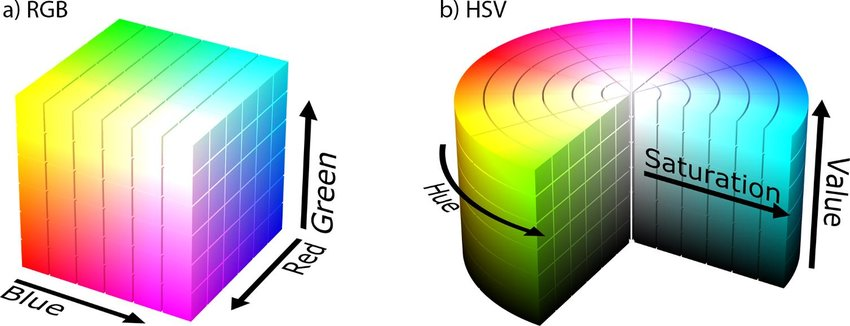

In [11]:
#diferenças entre as representações nos espaços RGB e HSV

import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img = cv.imread("hsv.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)

Convertendo para HSV:

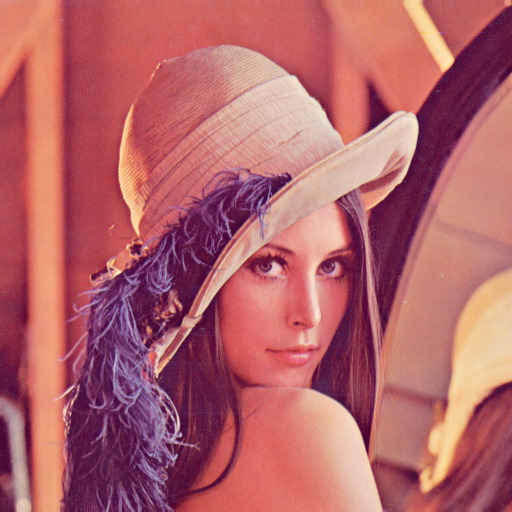

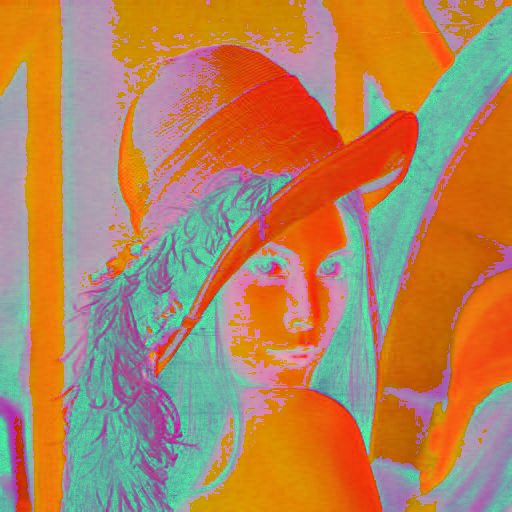

In [12]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img_bgr = cv.imread("lena.jpg")

if img is None:
    sys.exit("Could not read the image.")
    
cv2_imshow(img_bgr)
img_hsv = cv.cvtColor(img_bgr, cv.COLOR_BGR2HSV)
cv2_imshow(img_hsv)

Extraindo os canais matiz(H), Saturation(S) e Value(V) da conversão anterior.

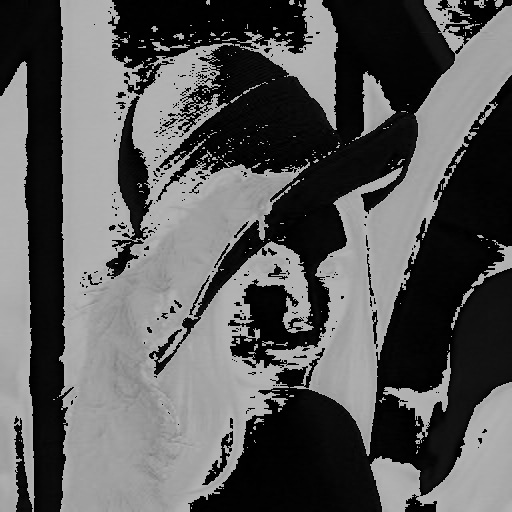

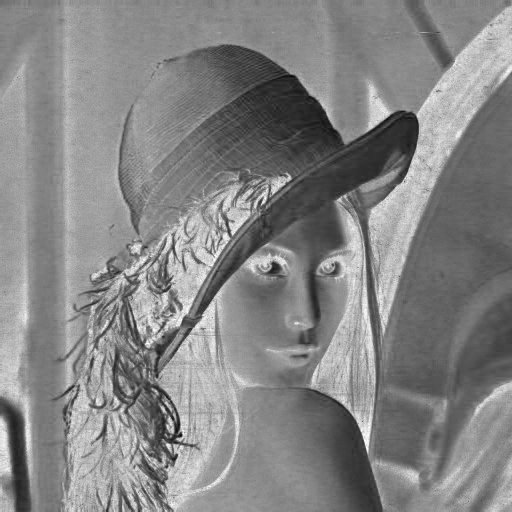

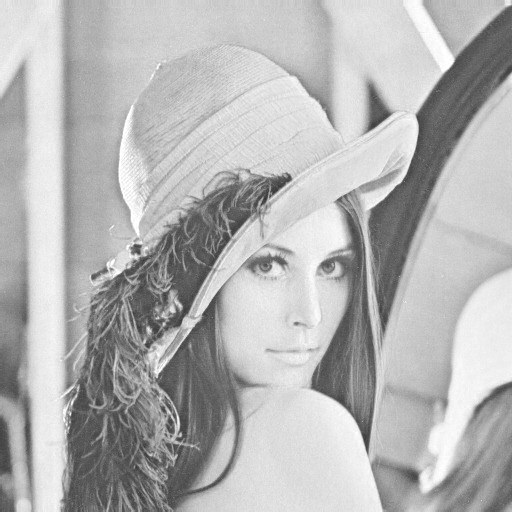

In [13]:
H,S,V = cv.split(img_hsv)
cv2_imshow(H)
cv2_imshow(S)
cv2_imshow(V)

Versão binarizada

(512, 512)


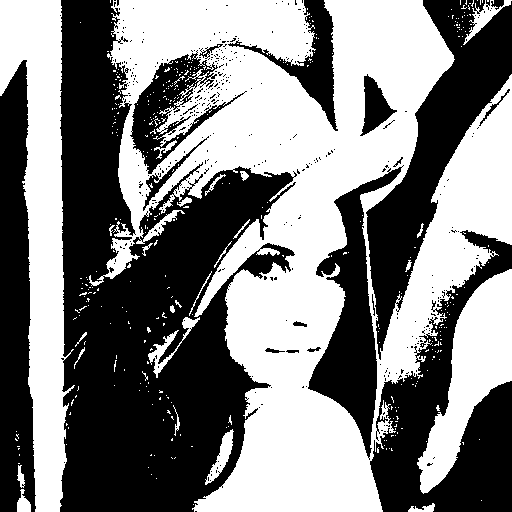

In [14]:
rows,cols =V.shape
print(V.shape)

T=np.median(V)

for l in range(rows):
  for c in range(cols):
    if V[l,c]<T:
      V[l,c]=0
    else:
      V[l,c]=255

cv2_imshow(V)

Para colorizar uma imagem em níveis de cinza utilizando a teoria do espaço de cor HSV, bastaria alterar o canal de matiz(H-hue)

Uma variação do espaço de cores HSV ((HUE-SATURATION-VALUE) é o HSL (HUE-SATURATION-LIGHTNESS)

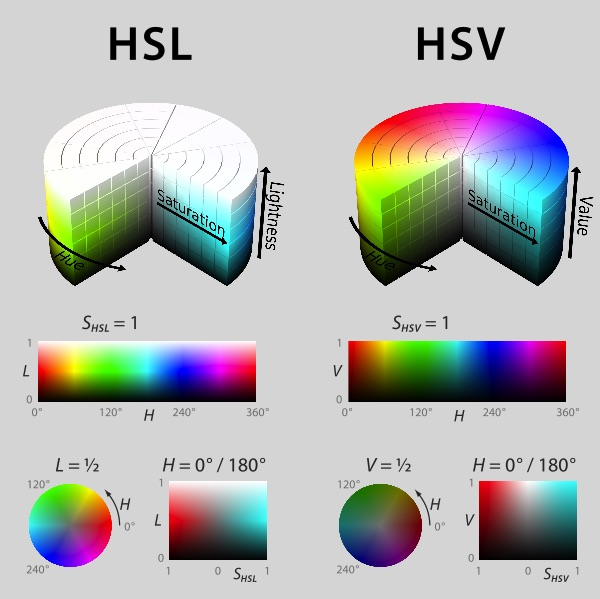

In [15]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import sys

img = cv.imread("hslhsv.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)

Convertendo a imagem para os espaços de cores HSV e HSL (em OpenCV chamado HLS)

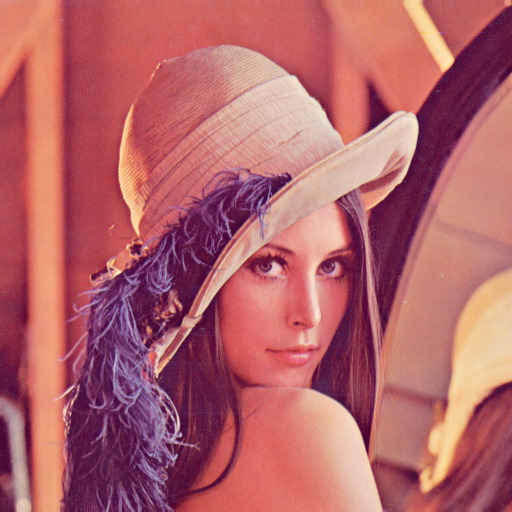

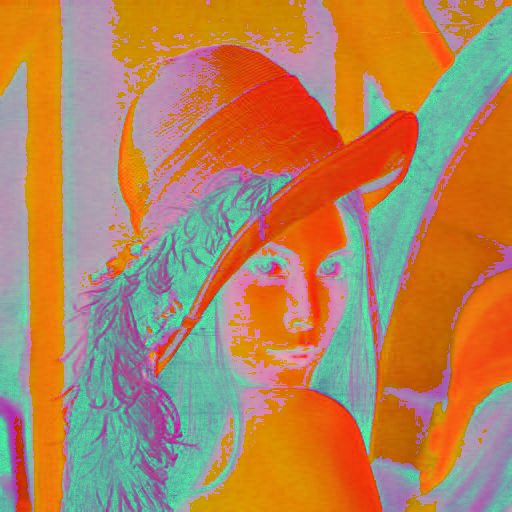

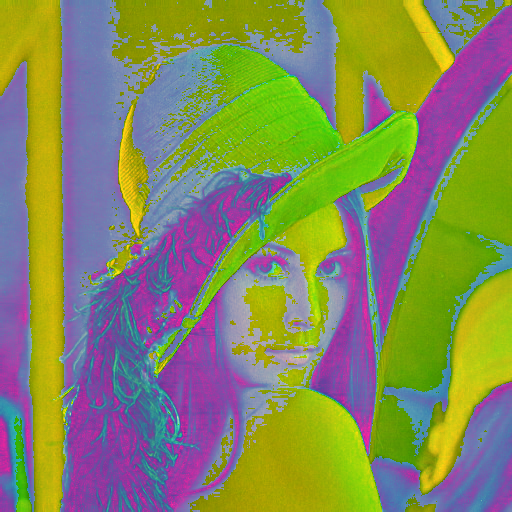

In [16]:
img_bgr = cv.imread("lena.jpg")

if img is None:
    sys.exit("Could not read the image.")

cv2_imshow(img_bgr)
img_hsv = cv.cvtColor(img_bgr, cv.COLOR_BGR2HSV) #BGR para HSV
cv2_imshow(img_hsv)


img_hsl = cv.cvtColor(img_bgr, cv.COLOR_BGR2HLS) #BGR para HSL
cv2_imshow(img_hsl)

In [ ]:
Produzindo uma versão binarizada da imagem lena.jpg usando a teoria do espaço de cores HSL

(512, 512)


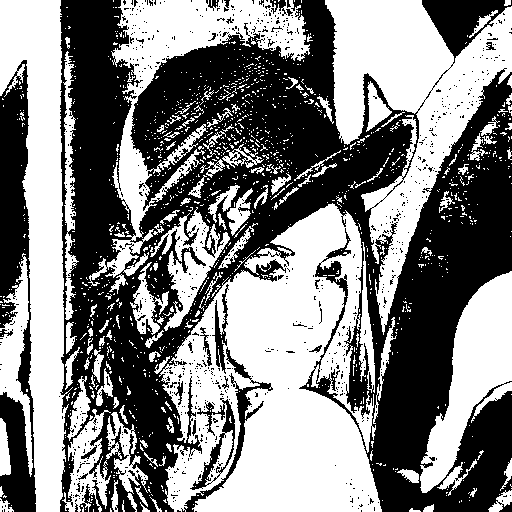

In [17]:
H,S,L=cv.split(img_hsl) #split nos canais

rows,cols=L.shape #tamanho 
print(L.shape)

T=np.median(L) #mediana dos pixels

for l in range(rows):
  for c in range(cols):
    if L[l,c] < T:
      L[l,c]=0
    else:
      L[l,c]=255
cv2_imshow(L)

Para colorizar uma imagem em níveis de cinza utilizando a teoria do espaço de cor HSV seria necessário alterar o canal de matiz.

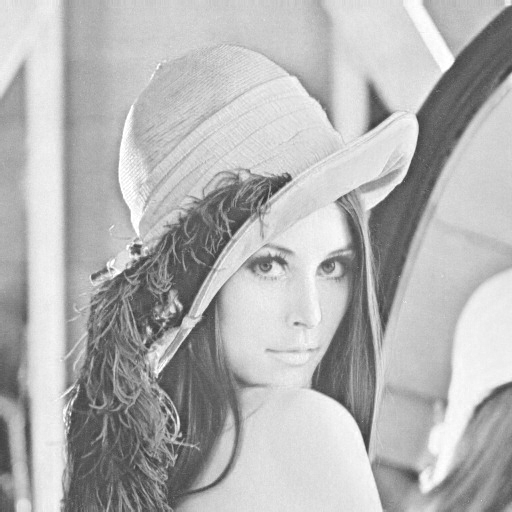

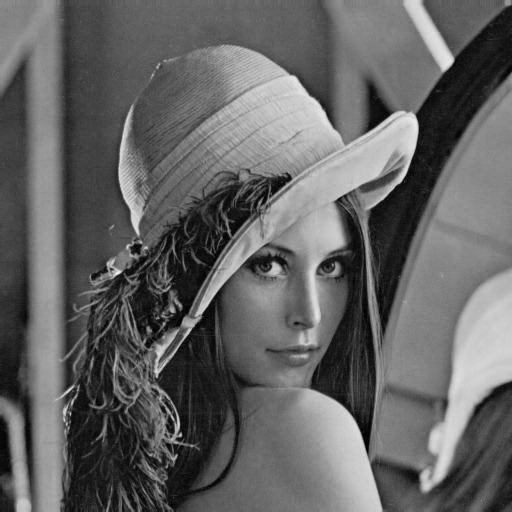

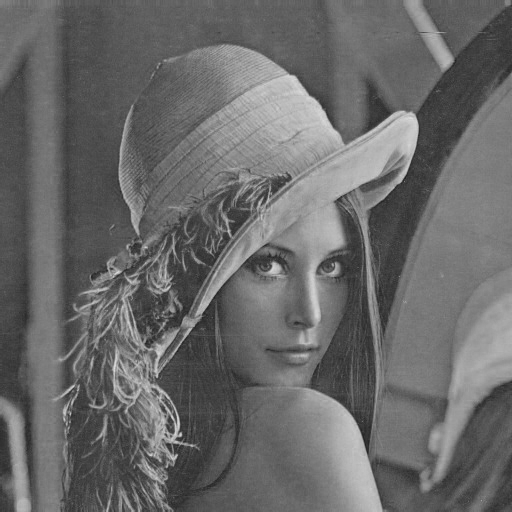

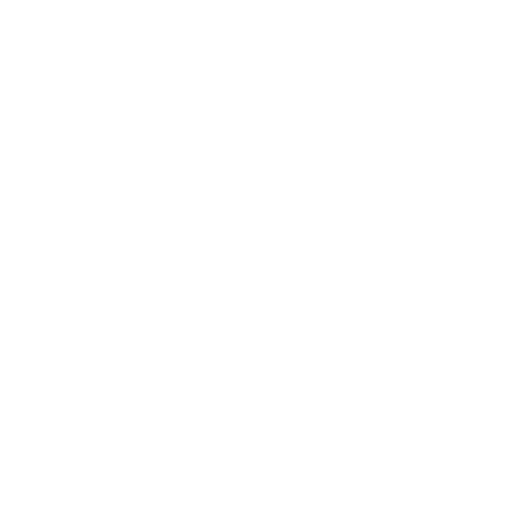

In [22]:
img_bgr = cv.imread("lena.jpg")
if img is None:
    sys.exit("Could not read the image.")

#cv2_imshow(img_bgr)
img_rgba = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGBA)

#cv2_imshow(img_rgba)
R,G,B,A=cv.split(img_rgba) #split nos canais
cv2_imshow(R)
cv2_imshow(G)
cv2_imshow(B)
cv2_imshow(A)

Espaço de cores YUV

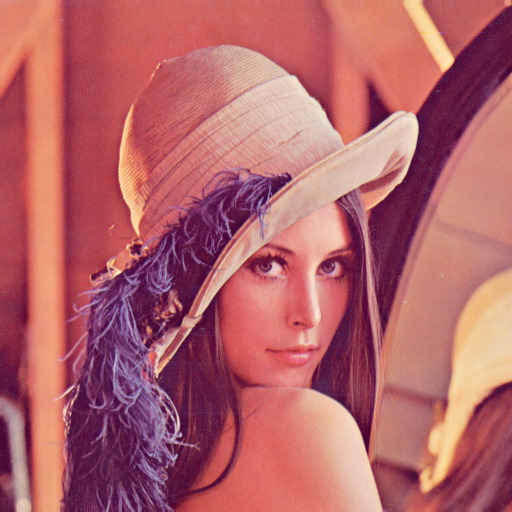

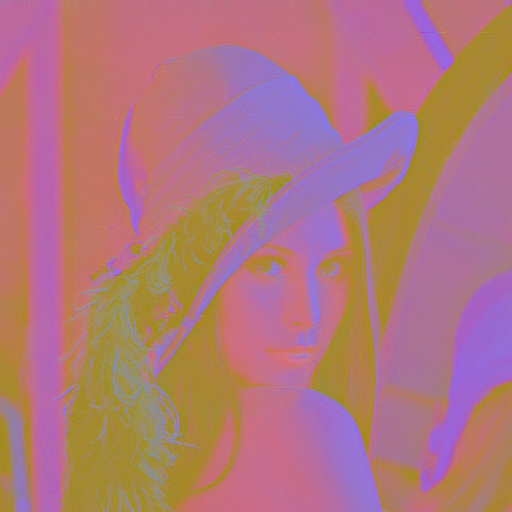

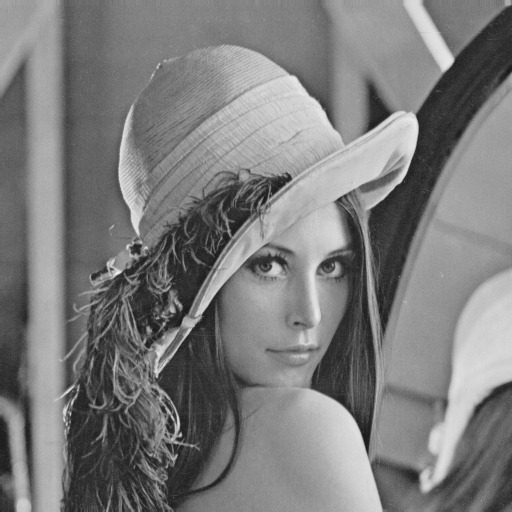

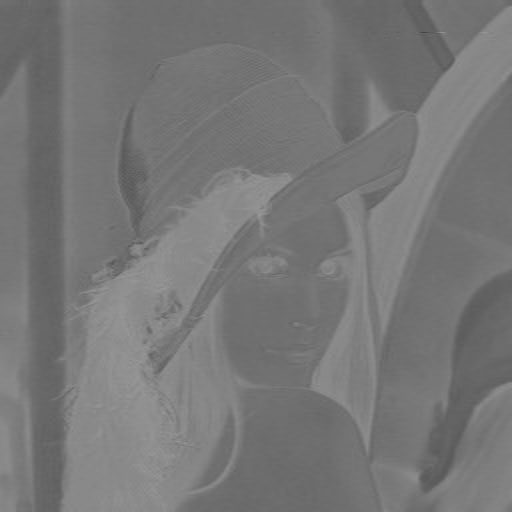

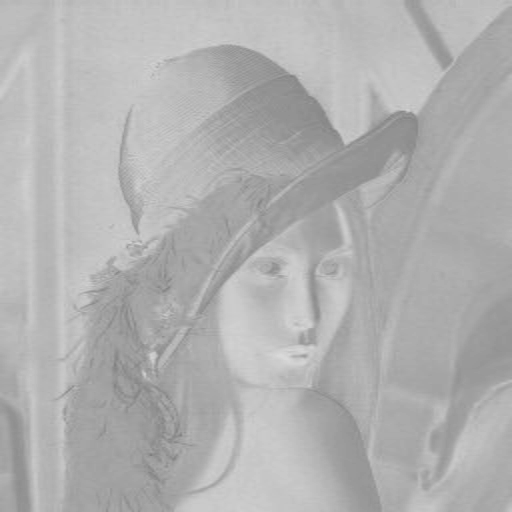

In [23]:
img_bgr = cv.imread("lena.jpg")
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img_bgr)
img_yuv = cv.cvtColor(img_bgr, cv.COLOR_BGR2YUV)
cv2_imshow(img_yuv)
Y,U,V = cv.split(img_yuv)
cv2_imshow(Y)
cv2_imshow(U)
cv2_imshow(V)

## **PROBLEMA DE INTENSIFICAÇÃO DE CONTRASTE**

A imagem abaixo possui um problema chamado baixo contraste. Isso ocorre quando temos uma concentração de cores numa determinada região da imagem.

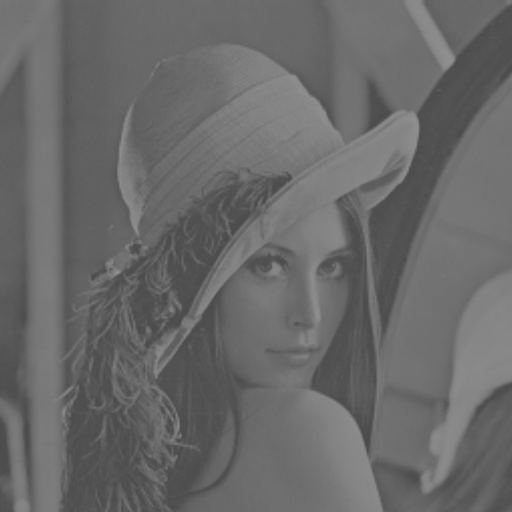

In [24]:
import cv2
from google.colab.patches import cv2_imshow
import sys

img = cv2.cvtColor(cv2.imread("lenabc.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)

EX.: A estratégia básica para intensificar contraste é diminuir esta concentração, aumentando a distância entre as cores dos pixels da imagem.

Estratégia abaixo:

-pixels "escuros" da imagem devem ficar mais escuros (ex. 20% mais escuros)

-pixels "claros" da imagem devem ficar mais claros (ex. 20% mais claros)

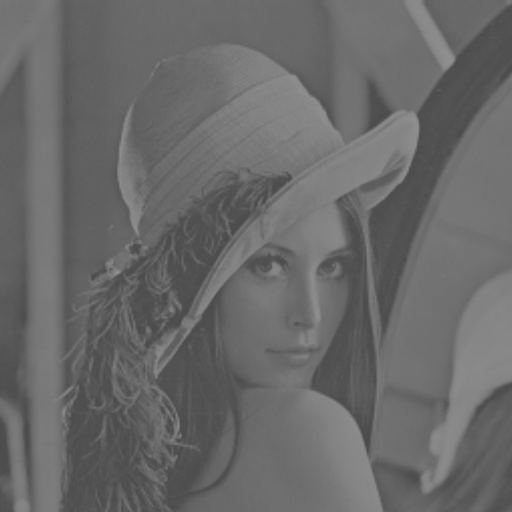

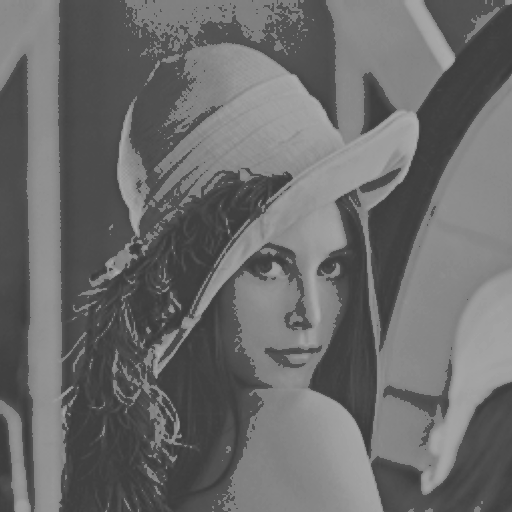

In [25]:
img = cv2.cvtColor(cv2.imread("lenabc.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)

linhas,colunas=img.shape

m=np.median(img)

for l in range(linhas):
  for c in range(colunas):
    if img[l][c]<m:
      img[l][c]*=0.8
    else:
      cl=1.2*img[l][c]
      if cl>255:
        img[l][c]=255
      else:
        img[l][c]=cl
      
cv2_imshow(img)

## **HISTOGRAMAS DE IMAGENS**

Com a utilização do conceito do histograma, vamos conseguir analisar mehor a distribuição de cores e atuar em cima da distribuição de cores para intensificar contraste.

Um histograma de cores nos mostra qual é a quantidade de pixels por cada cor.

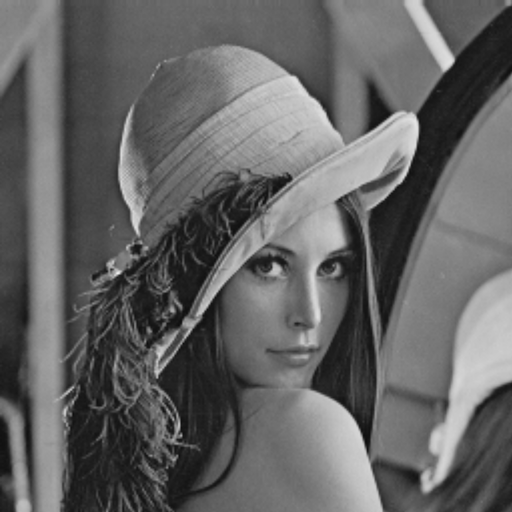

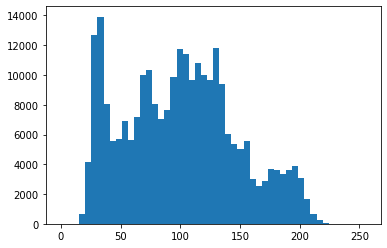

In [27]:
#como calcular o histograma de cores de uma imagem

import cv2
from google.colab.patches import cv2_imshow
import sys
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

img = cv2.cvtColor(cv2.imread("lenagray.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)
h=plt.hist(img.ravel(),bins=50,range=[0,255]) #ravel() transforma a imagem num vetor 1D
plt.show()

## **ANALISANDO A IMAGEM POR HISTOGRAMAS**

Quando uma imagem nos parece nítida, possivelmente ela terá uma boa distribuição de cores.

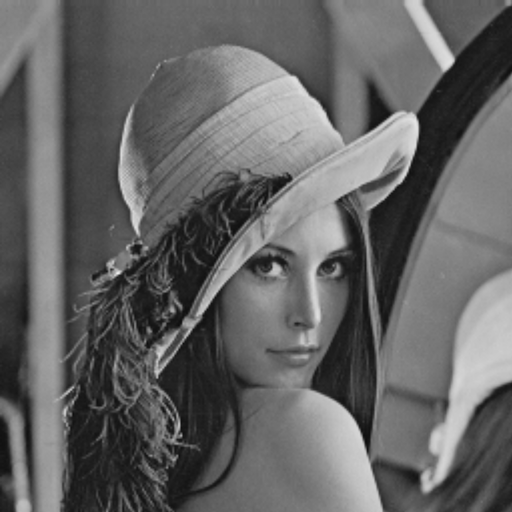

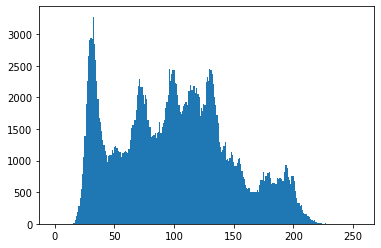

In [28]:
import cv2
from google.colab.patches import cv2_imshow
import sys
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

img = cv2.cvtColor(cv2.imread("lenagray.png"), cv2.COLOR_BGR2GRAY) 

if img is None:
    sys.exit("Could not read the image.")
    
cv2_imshow(img)
plt.hist(img.ravel(),bins=256,range=[0,255]) #ravel() transforma a imagem num vetor 1D
plt.show()

Para imagens mais claras ou mais escuras, teremos concentrações em determinadas regiões do histograma.

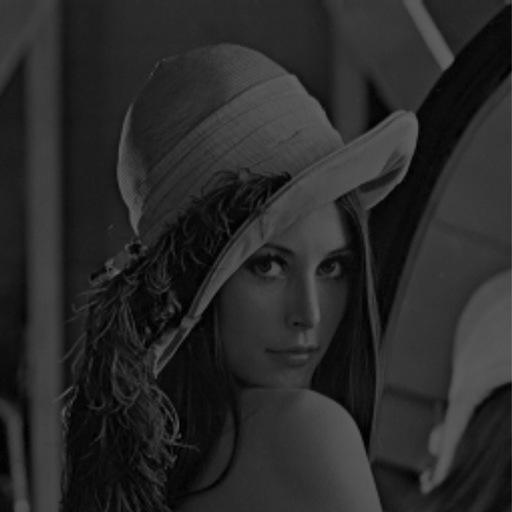

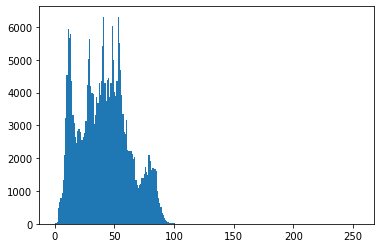

In [29]:
import cv2
from google.colab.patches import cv2_imshow
import sys
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

img = cv2.cvtColor(cv2.imread("lenadark.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)
plt.hist(img.ravel(),bins=256,range=[0,255]) #ravel() transforma a imagem num vetor 1D
plt.show()

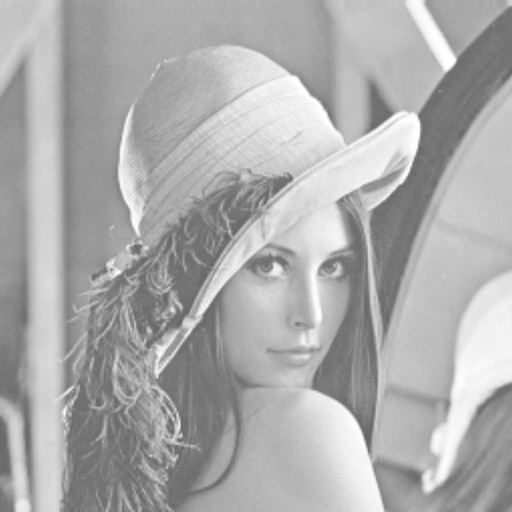

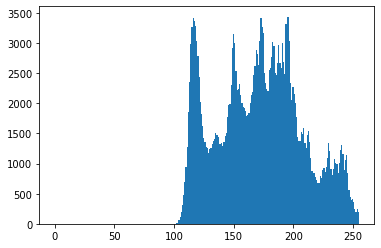

In [30]:
import cv2
from google.colab.patches import cv2_imshow
import sys
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

img = cv2.cvtColor(cv2.imread("lenabright.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)
plt.hist(img.ravel(),bins=256,range=[0,255]) #ravel() transforma a imagem num vetor 1D
plt.show()

Analisando o histograma da imagem com baixo contraste:

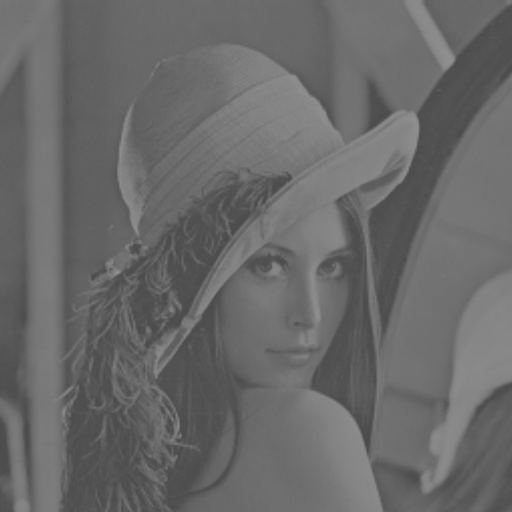

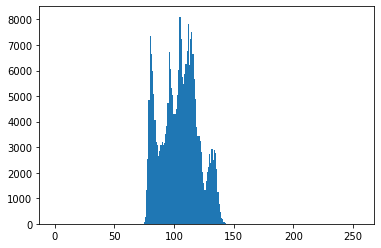

In [31]:
import cv2
from google.colab.patches import cv2_imshow
import sys
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

img = cv2.cvtColor(cv2.imread("lenabc.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)    
plt.hist(img.ravel(),bins=256,range=[0,255]) #ravel() transforma a imagem num vetor 1D
plt.show()

Podemos observar que o histograma acima está muito concentrado numa determinada região. O que precisamos fazer é redistribuir melhor estas cores, "esticando" horizontalmente o histograma.

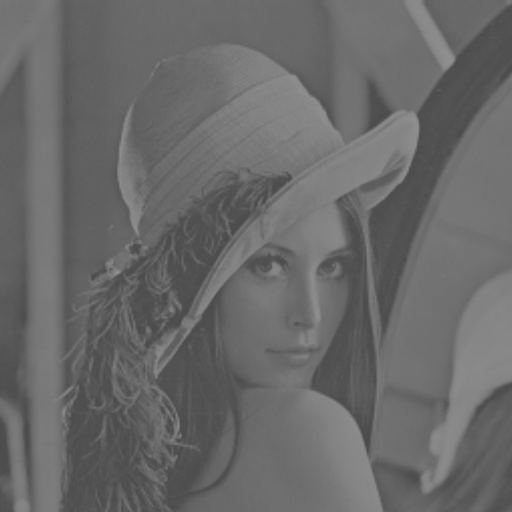

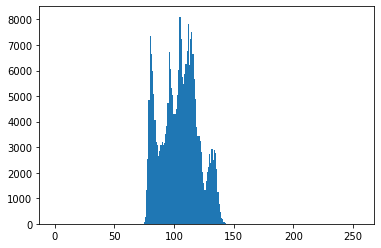

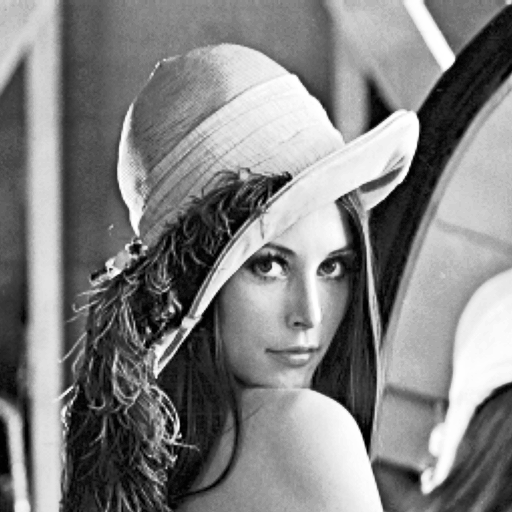

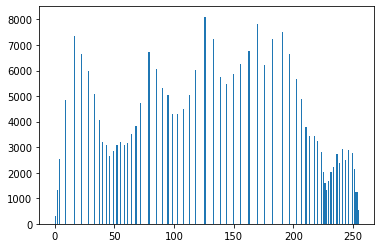

In [32]:
import cv2
from google.colab.patches import cv2_imshow
import sys
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

img = cv2.cvtColor(cv2.imread("lenabc.png"), cv2.COLOR_BGR2GRAY)

if img is None:
    sys.exit("Could not read the image.")

cv2_imshow(img)
plt.hist(img.ravel(),bins=256,range=[0,255]) 
plt.show()

imgeq=cv2.equalizeHist(img) #equalizando o histograma
cv2_imshow(imgeq)
plt.hist(imgeq.ravel(),bins=256,range=[0,255]) 
plt.show()

## **IMPLEMENTANDO A EQUALIZAÇÃO DE HISTOGRAMA MANIPULANDO O PRÓPRIO HISTOGRAMA**

https://en.wikipedia.org/wiki/Histogram_equalization

No código fornecido abaixo, hist representa o objeto do histograma. 

Dica: (1) Calcule primeiro a distribuição de probabilidade acumulada (cdf) do histograma
(2) use arrays mascarados do numpy

In [33]:
import cv2
from google.colab.patches import cv2_imshow
import sys
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

img = cv2.cvtColor(cv2.imread("lenabc.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
hist,bins = np.histogram(img.flatten(),255,[0,255])

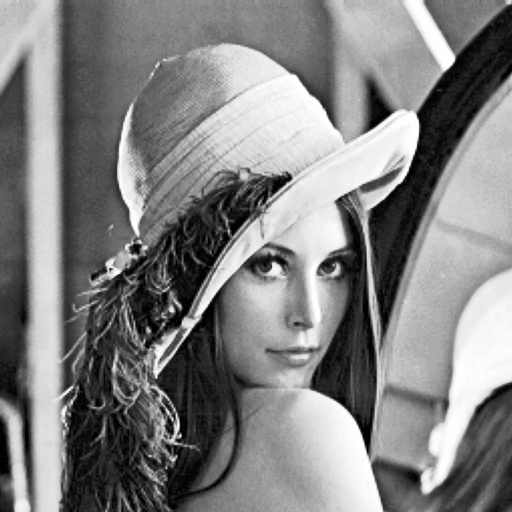

In [34]:
cdf = hist.cumsum()
cdf_m = np.ma.masked_equal(cdf,0)
cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())
cdf = np.ma.filled(cdf_m,0).astype('uint8')
imgeq = cdf[img]
cv2_imshow(imgeq)

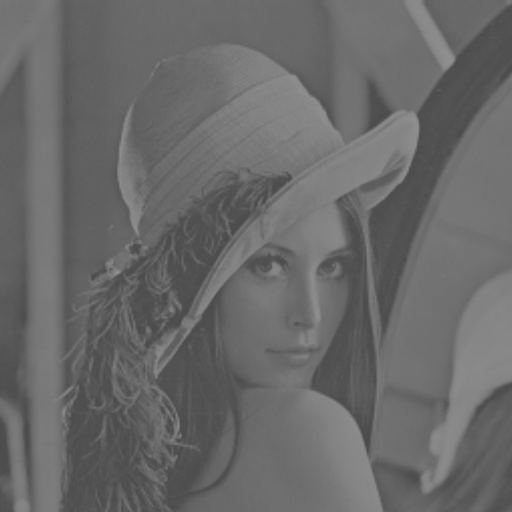

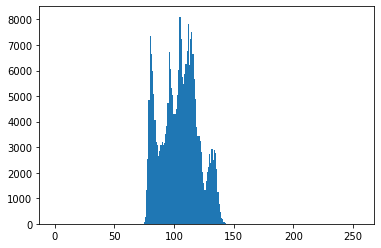

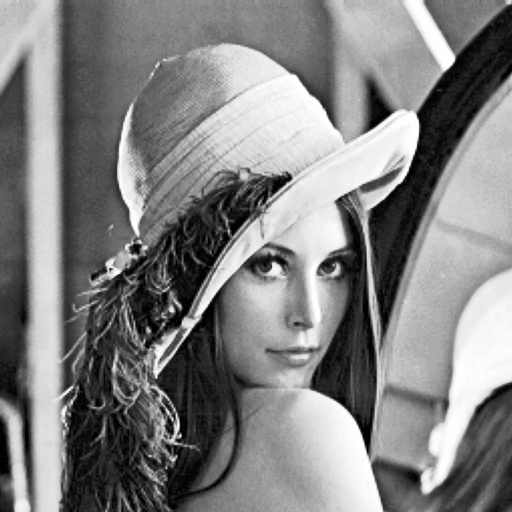

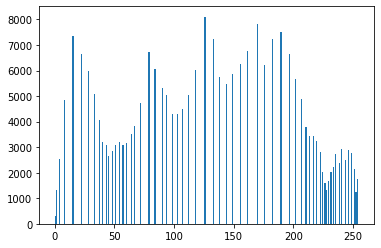

In [35]:
img = cv2.cvtColor(cv2.imread("lenabc.png"), cv2.COLOR_BGR2GRAY)
if img is None:
    sys.exit("Could not read the image.")
cv2_imshow(img)
plt.hist(img.ravel(),bins=256,range=[0,255]) 
plt.show()

cv2_imshow(imgeq)
plt.hist(imgeq.ravel(),bins=256,range=[0,255]) 
plt.show()

## **TRANSFORMAÇÃO DE THRESHOLDING (LIMIARIZAÇÃO)**

**Thresholding (limiarização ou binarização)** consiste na **quantização** do espaço de cores para **duas cores**, normalmente **preto e branco**. Este é um procedimento bastante comum em Processamento de Imagens e Visão Computacional antes de aplicarmos outros procedimentos como detecção de contornos, reconhecimento de formas, operações morfológicas, dentre outros.

O efeito de um bom threshold é mostrado abaixo:

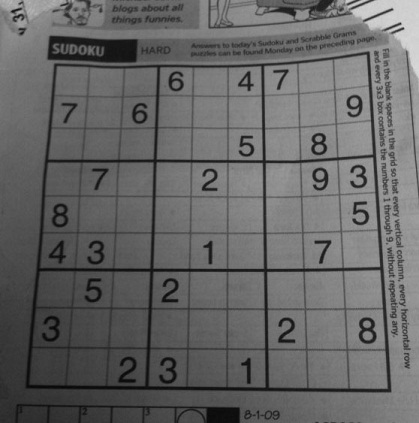

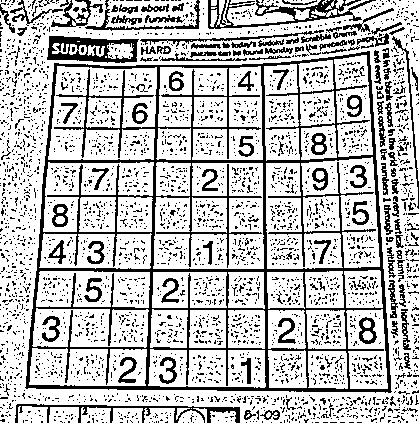

In [36]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)
imgt = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,cv.THRESH_BINARY,11,2)
cv2_imshow(img)
cv2_imshow(imgt)

### **ALGORITMO BÁSICO (GLOBAL) DE THRESHOLDING**

A implementação mais elementar de um algoritmo de thresholding  consiste na definição de um limiar (*threshold*). Valores abaixo deste limiar, são considerados como preto e, valores acima, considerados como brancos.

Em OpenCV, isto pode ser feito segundo o exemplo abaixo, onde fixamos o limiar como 127.

Threshold 127.0


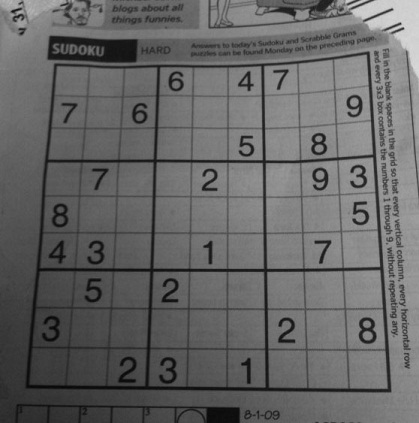

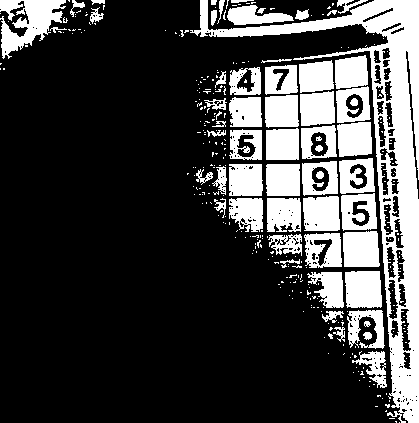

In [37]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)
T,imgt = cv.threshold(img,127,255,cv.THRESH_BINARY)
print("Threshold",T)
cv2_imshow(img)
cv2_imshow(imgt)

Algoritmo de thresholding que retorna o mesmo resultado da constante cv.THRESH_BINARY, utilizando o mesmo limiar (127).

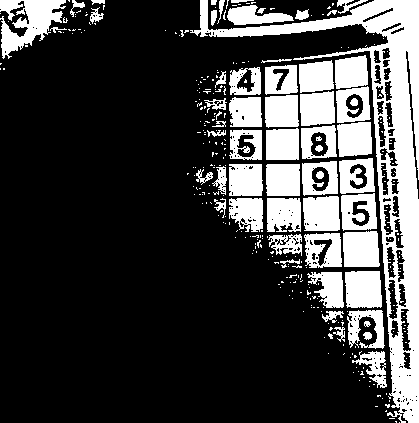

In [38]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)
rows,cols=img.shape
T=127
for l in range(rows):
  for c in range(cols):
    if img[l,c]<=T:
      img[l,c]=0
    else:
      img[l,c]=255
cv2_imshow(img)

O valor de limiar de 127 não é o mais adequado para todas as imagens. Para isso podemos utilizar a mediana para definir o limiar.

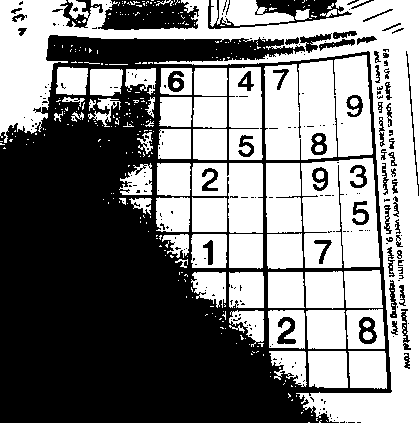

In [39]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)
rows,cols=img.shape

T=np.median(img) #mediana para definir o limiar

for l in range(rows):
  for c in range(cols):
    if img[l,c]<=T:
      img[l,c]=0
    else:
      img[l,c]=255
cv2_imshow(img)

Equalizando o histograma da imagem original para ver se conseguimos melhorar os resultados. 

O resultado não melhora:

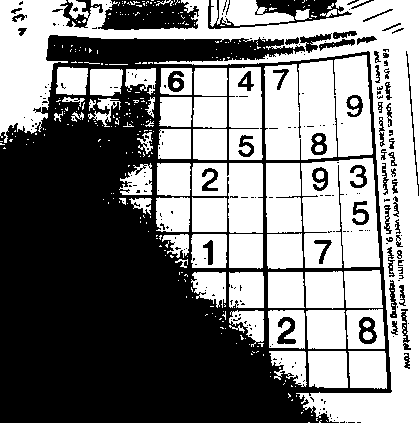

In [40]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)
rows,cols=img.shape
img=cv.equalizeHist(img)
T=np.median(img)
for l in range(rows):
  for c in range(cols):
    if img[l,c]<=T:
      img[l,c]=0
    else:
      img[l,c]=255
cv2_imshow(img)

Uma boa estratégia antes de aplicarmos o algoritmo básico de thresholding é "borrar" a imagem. Abaixo temos um exemplo de como borrar a imagem, utilizando um filtro gaussiano.

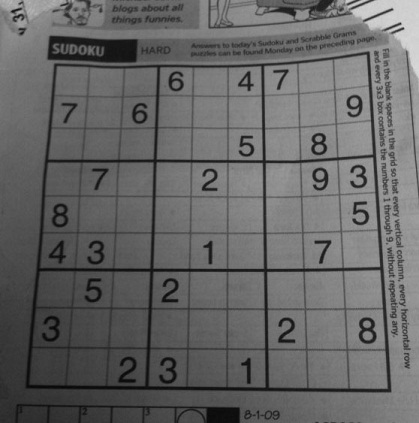

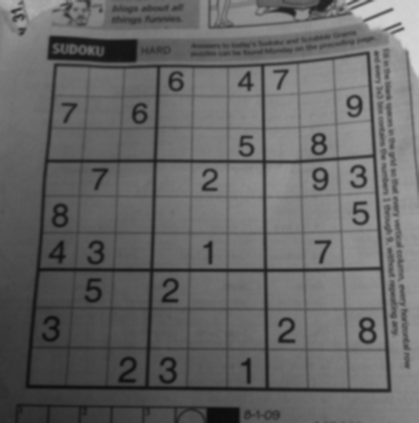

In [43]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)

blur = cv.GaussianBlur(img,(5,5),0) #borrando a imagem com o filtro gaussiano

cv2_imshow(img)
cv2_imshow(blur)

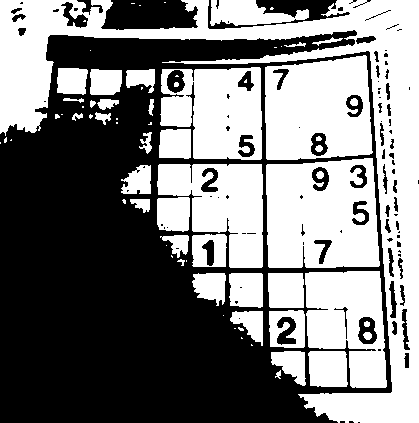

In [44]:
T=np.median(blur)
for l in range(rows):
  for c in range(cols):
    if blur[l,c]<=T:
      blur[l,c]=0
    else:
      blur[l,c]=255
cv2_imshow(blur)

### **ALGORITMO DE OTSU**

Nesta estratégia, supomos que o histograma tenha um comportamento bimodal. Encontramos dois picos neste histograma e calculamos a média entre eles. Esta média será nosso valor de threshold.

Aplicação deste algoritmo em OpenCV:

Threshold 96.0


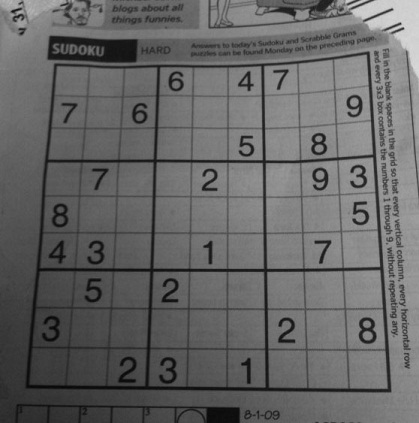

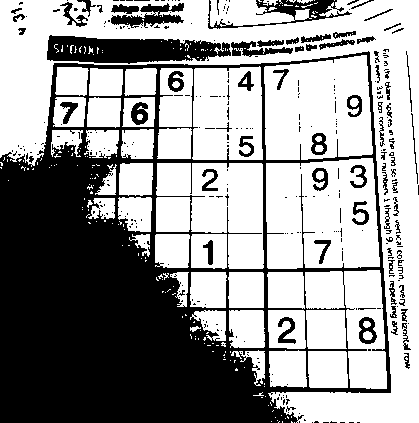

In [45]:
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)

T,imgt = cv.threshold(img,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU) #implementação algoritmo de otsu

print("Threshold",T)
cv2_imshow(img)
cv2_imshow(imgt)

Implementar o Algoritmo de Otsu para determinar o valor do threshold T. A partir deste valor, usar o algoritmo básico de thresholding.

https://github.com/mohabmes/Otsu-Thresholding/blob/master/otsu.py

### **THRESHOLDING ADAPTATIVO**

No thresholding adaptativo, ao invés de considerarmos somente a cor (nível de cinza) do pixel, consideramos uma vizinhança do pixel, aplicamos uma operação nesta vizinhança (média,borramento) e obtemos um novo valor de cor para o pixel, que pode ser modulado por uma contante C. A partir deste novo valor, aplicamos o threshold anterior.

Abaixo temos um exemplo com uma vizinhança de tamanho 3 (um pixel para a direita, um pixel para a esquerda, um pixel para baixo e umpixel para cima) e constante C=4.


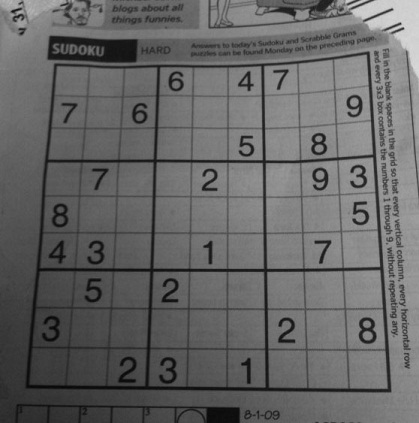

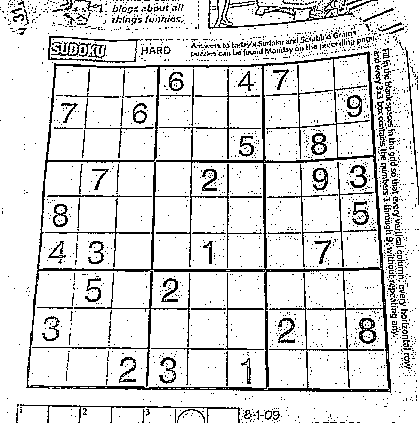

In [46]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)

#thresholding adaptativo
imgt = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_MEAN_C,cv.THRESH_BINARY,3,4)

cv2_imshow(img)
cv2_imshow(imgt)

Influência do tamanho da vizinhança no resultado do thresholding adaptativo:

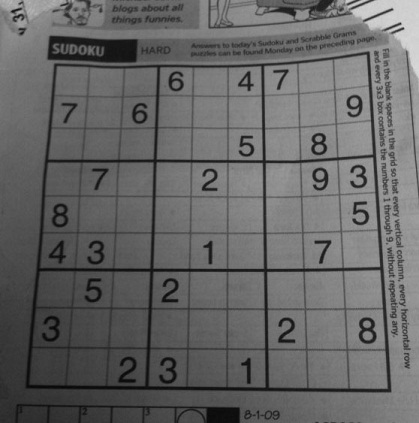

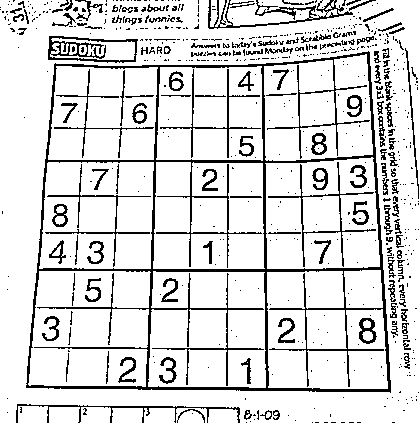

In [48]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)
imgt = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_MEAN_C,cv.THRESH_BINARY,5,6)
cv2_imshow(img)
cv2_imshow(imgt)

#sempre importante notar que queremos o que está próximo

Se incluirmos uma filtragem gaussiana ("borramento") junto com o thrasholding adaptativo, conseguimos um resultado muito melhor.

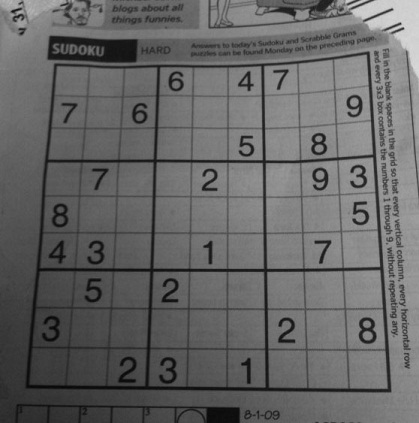

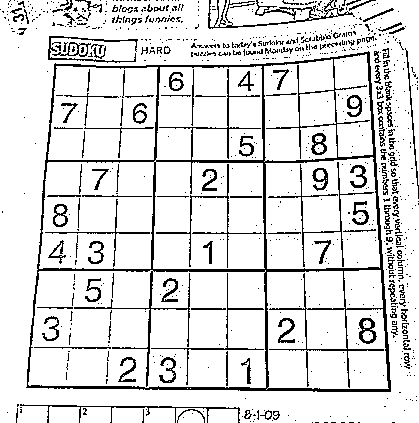

In [49]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
img = cv.cvtColor(cv.imread('sudoku.jpg'), cv.COLOR_BGR2GRAY)
imgt = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,cv.THRESH_BINARY,5,5)
cv2_imshow(img)
cv2_imshow(imgt)

## **DETECÇÃO DE CONTORNOS (BORDOS)**

Um contorno ou um bordo de uma imagem 2D é um segmento poligonal que divide regiões de intensidades distintas. Abaixo, temos um exemplo de cálculo de contorno de uma imagem 2D, realizada pelo filtro de Canny. 

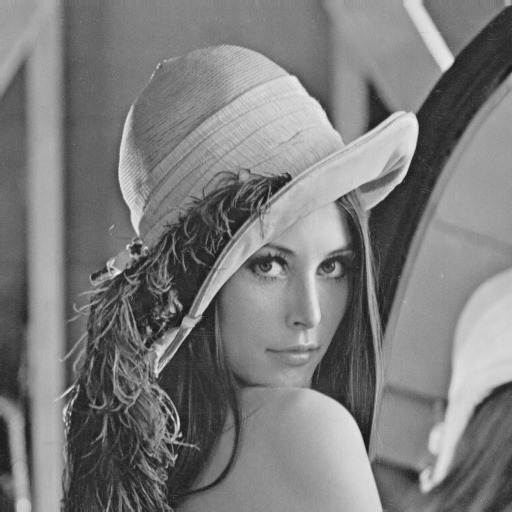

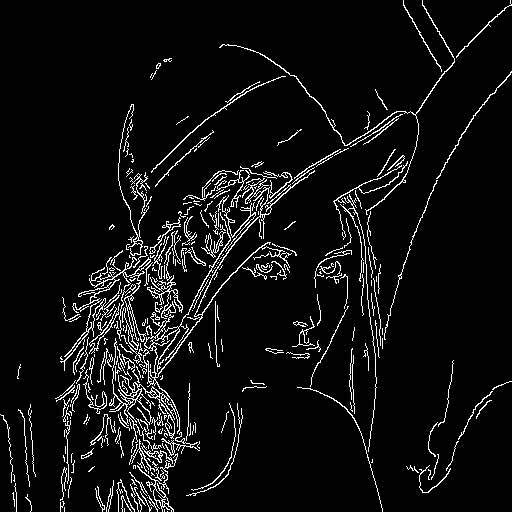

In [53]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)

edges = cv.Canny(img,100,200) #identificar contorno
cv2_imshow(img)
cv2_imshow(edges)

Existem diversas abordagens para cálculo de contornos de imagem: a propria função f(x,y) da imagem, sua derivada primeira f' e sua derivada segunda f''.

Implementação da detecção de contornos usando somente a variação f(x,y).

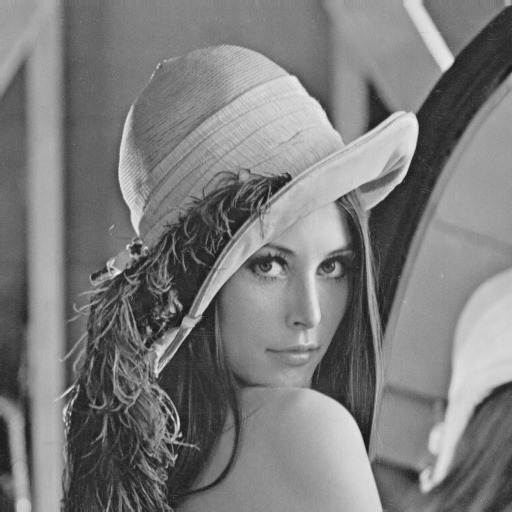

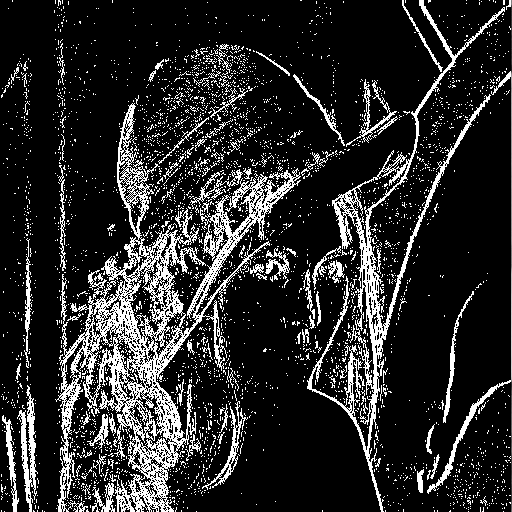

In [54]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY).astype(np.int32)

cv2_imshow(img)

rows, cols=img.shape
T=10
for l in range(rows):
  for c in range(cols-1):
    if abs(img[l,c]-img[l,c+1])>T:
      img[l,c]=255
    else:
      img[l,c]=0
cv2_imshow(img)

A variação da função também pode ser calculada através de um produto de convolução da imagem por um kernel de variação.

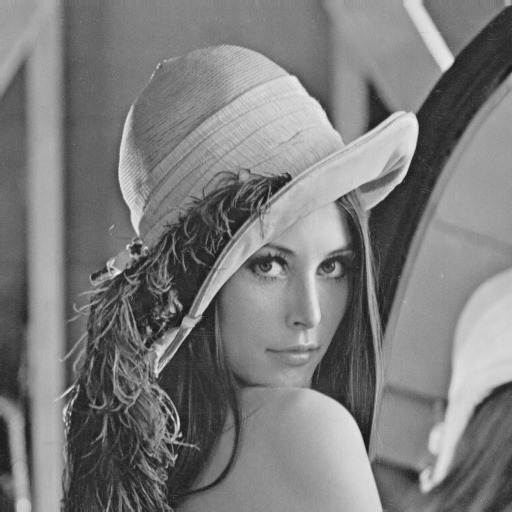

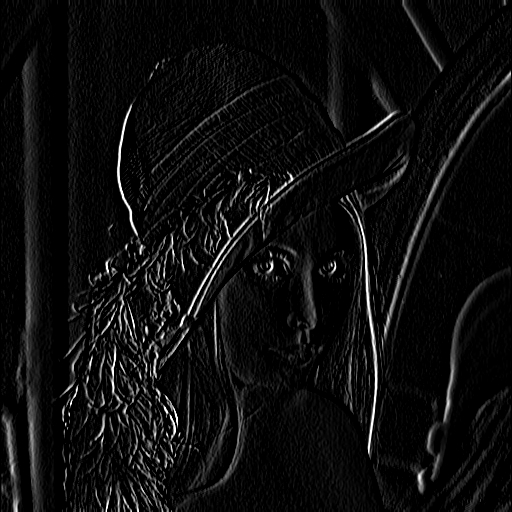

In [55]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)
cv2_imshow(img)

kernel = np.array((
	[-1, 0, 1],
	[-1, 0, 1],
	[-1, 0, 1]), dtype="int")

imgf= cv.filter2D(img,-1, kernel)  # -1 indica que a profundidade de cores da saída será a mesma da entrada
cv2_imshow(imgf)

## **DETECÇÃO DE CONTORNOS COM A PRIMEIRA DERIVADA**

O Filtro Sobel aproxima o gradiente (derivada primeira) da função f(x,y), obtendodois filtros de detecção de contornos, um para horizontal e outro para vertical.

Para aplicar estes dois filtros, usamos as seguintes funções em OpenCV:

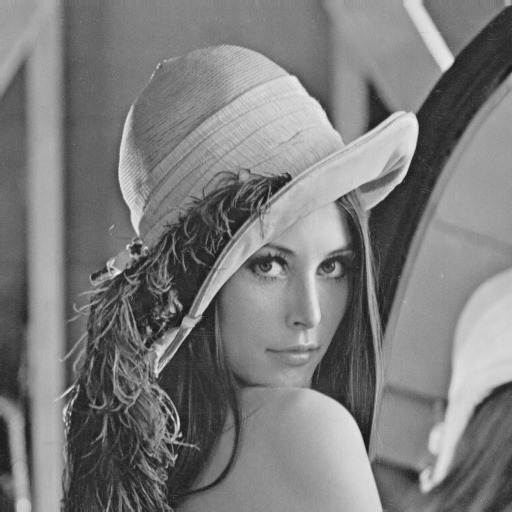

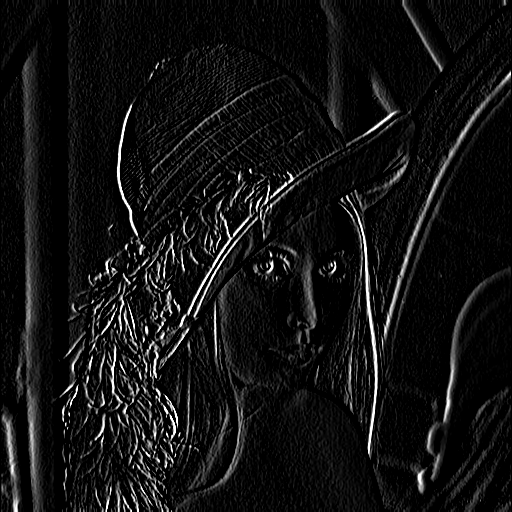

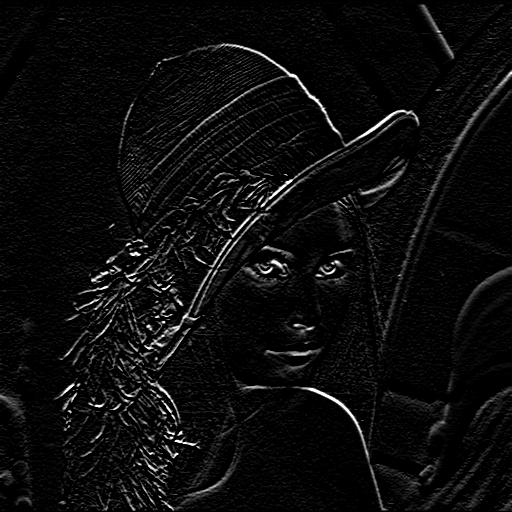

In [56]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)
cv2_imshow(img)

#implementação
sobelx = cv.Sobel(img,cv.CV_64F,1,0)
sobely = cv.Sobel(img,cv.CV_64F,0,1)
cv2_imshow(sobelx)
cv2_imshow(sobely)

Aplicando os filtros de Sobel utilizando o operador de convolução da OpenCV:

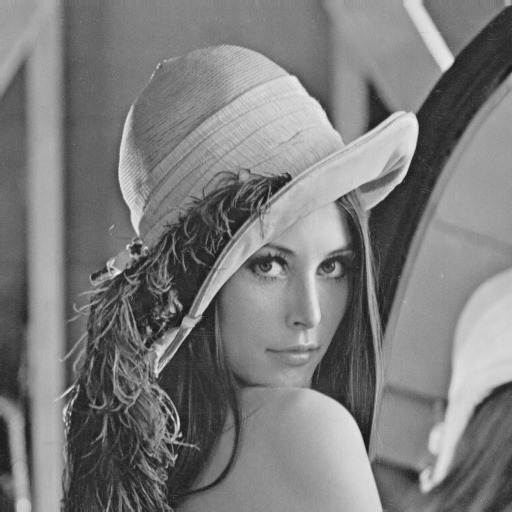

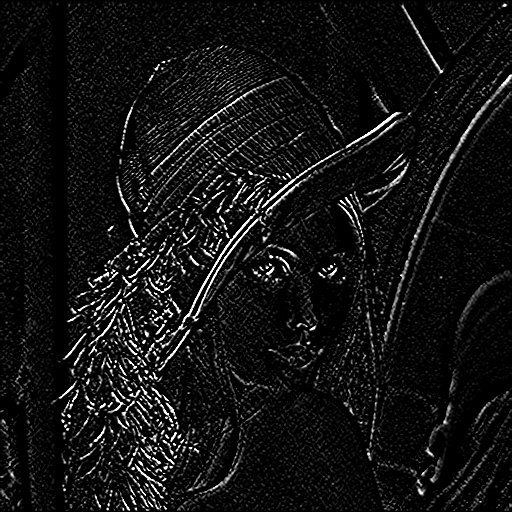

In [57]:
img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)
cv2_imshow(img)

kernel = np.array((
	[-1, 0, 1],
	[-2, 0, 2],
	[-1, 0, 1]), dtype="int")

img= cv.filter2D(img,-1, kernel)  # -1 indica que a profundidade de cores da saída será a mesma da entrada

kernel = np.array((
	[1, 2, 1],
	[0, 0, 0],
	[-1, -2, -1]), dtype="int")
img= cv.filter2D(img,-1, kernel)
cv2_imshow(img)

## **DETECÇÃO DE CONTORNOS COM O FILTRO DE CANNY**

O Filtro de Canny oferece uma maneira alternativa de uso do gradiente da função, sendo um método bastante usado em OpenCV. A Teoria do Filtro de Canny encontra-se abaixo:

https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_canny/py_canny.html

Vamos aplicá-lo novamente a imagem, como vimos no início da aula:

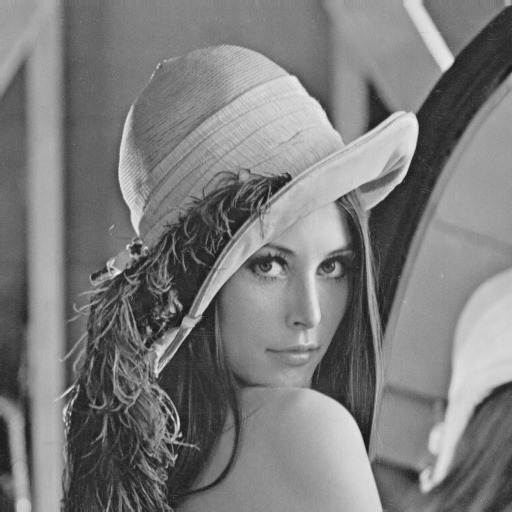

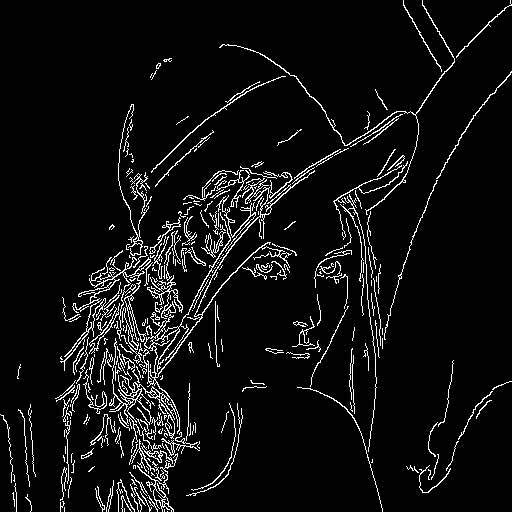

In [58]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)
edges = cv.Canny(img,100,200) #filtro de Canny
cv2_imshow(img)
cv2_imshow(edges)

Aplicando o Filtro de Canny com diferentes valores de minVal e maxVal, observando as diferenças de aplicação:

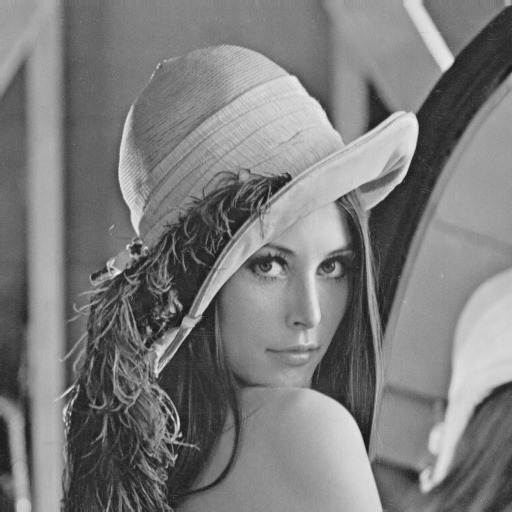

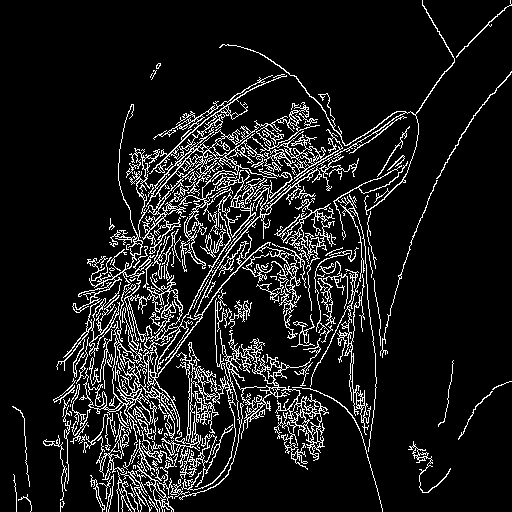

In [63]:
img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)

#edges = cv.Canny(img,minVal,maxVal)
edges = cv.Canny(img,10,300)

cv2_imshow(img)
cv2_imshow(edges)

#quanto maior o range mais linhas

## **DETECÇÃO DE CONTORNOS COM A SEGUNDA DERIVADA**

O Filtro Laplaciano aproxima o laplaciano (derivada segunda) da função f(x,y), obtendo a seguinte matriz de filtro.

Para aplicar o filtro laplaciano para detecção de bordos, usamos o seguinte código em OpenCV:

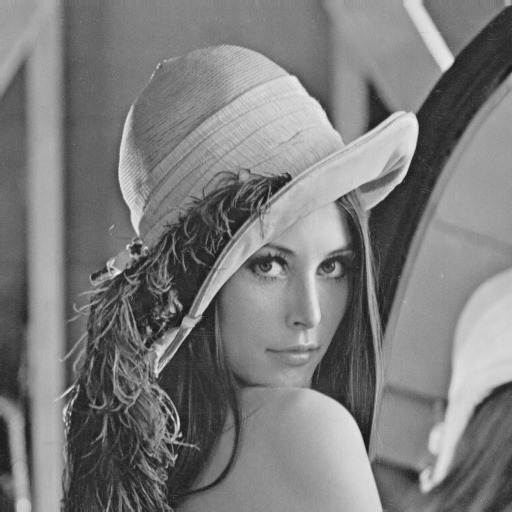

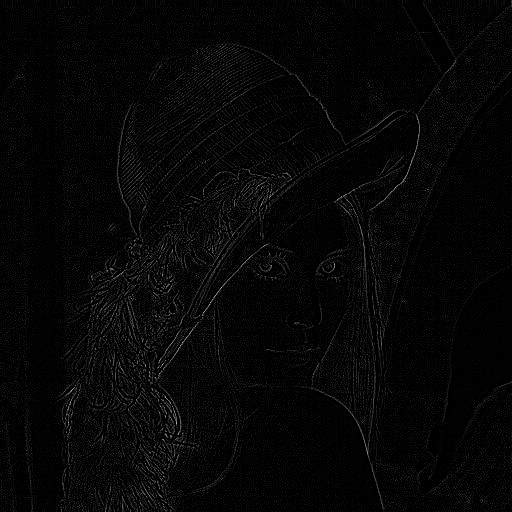

In [64]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)
cv2_imshow(img)

#implementando o filtro laplaciano
lap = cv.Laplacian(img,cv.CV_64F)
cv2_imshow(lap)

Aplicando o filtro laplaciano utilizando o operador de convolução da OpenCV:

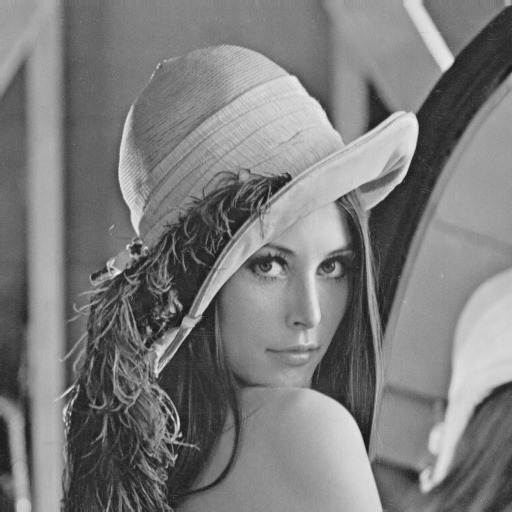

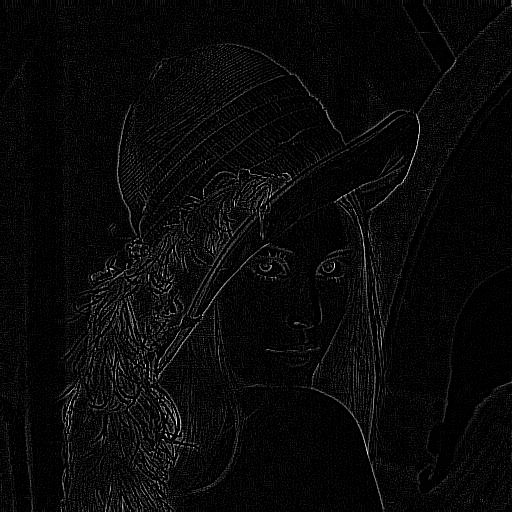

In [65]:
img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)
cv2_imshow(img)

kernel = np.array((
	[1, 0, 1],
	[0, -4, 0],
	[1, 0, 1]), dtype="int")

img= cv.filter2D(img,-1, kernel)  # -1 indica que a profundidade de cores da saída será a mesma da entrada
cv2_imshow(img)

## **FILTRAGEM NO DOMÍNIO ESPACIAL**

A **filtragem no domínio espacial** ocorre com a aplicação de **filtros** (matrizes), posicionados sob cada pixel da imagem. Estes filtros, normalmente, são chamados de **kernels (ou núcleos)**. O resultado final do valor do pixel é calculado através de um **produto de convolução**.

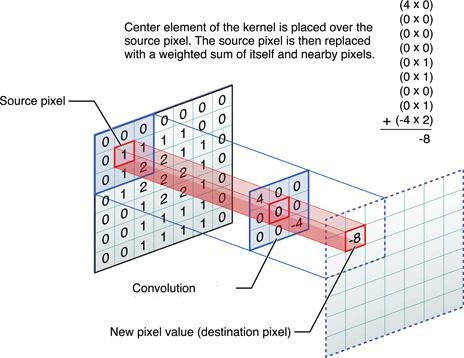

In [66]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
img = cv.imread('convolution.png')
cv2_imshow(img)


Existem diversos problemas de Visão Computacional e Processamento de Imagens que podem ser resolvidos com o processo de produto de convolução.

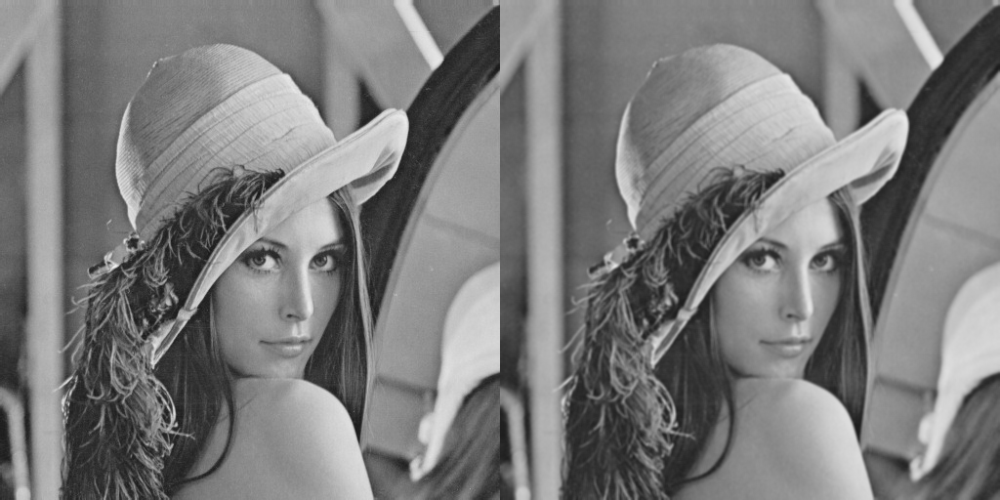

In [68]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

img = cv.imread('lena.png',0)

#utilizando o filter2D
kernel = np.ones((3,3),np.float32)/9
imgf = cv.filter2D(img,-1,kernel)
cv2_imshow(np.hstack((img,imgf)))

O filtro da imagem anterior faz um "borramento na imagem"

Implementando o processo de convolução com o kernel dado, comparando os resultados com o filter2D

uint8


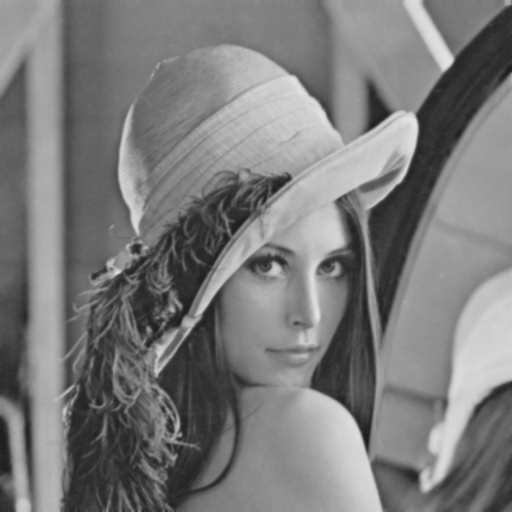

In [69]:
img = cv.imread('lena.png',0)
rows,cols=img.shape
print(img.dtype)
for l in range (1,rows-1):
  for c in range (1,cols-1):
    img[l,c]=(img[l-1,c-1].astype(np.int16)+img[l-1,c].astype(np.int16)+img[l-1,c+1].astype(np.int16)+
              img[l,c-1].astype(np.int16)+img[l,c].astype(np.int16)+img[l,c+1].astype(np.int16)+
              img[l+1,c-1].astype(np.int16)+img[l+1,c].astype(np.int16)+img[l+1,c+1].astype(np.int16))/9
cv2_imshow(img)

O procblema de calcular a convolução nos bordos da imagem é que não temos valores associados aos pixels de fora da imagem. Para isto, podemos colocar uma "moldura" em torno da imagem.

O código abaixo irá colocar uma moldura de 1 pixel em torno da imagem.

(514, 514)


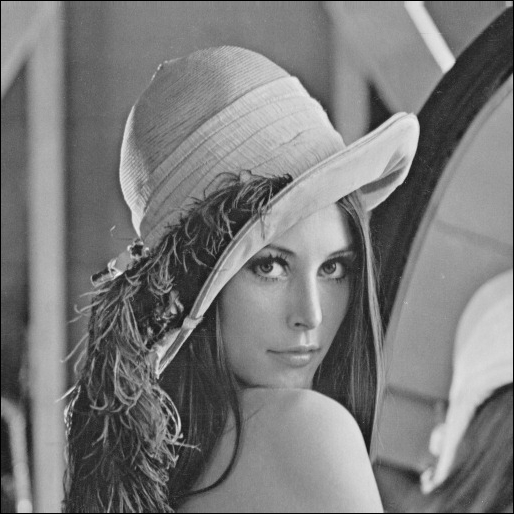

In [70]:
img = cv.imread('lena.png',0)
rows, cols = img.shape
T = np.float32([ [1,0,1], 
                 [0,1,1] ])
imgt= cv.warpAffine(img, T, (cols+2, rows+2))
print(imgt.shape) 
cv2_imshow(imgt)

Implementando o produto de convolução, porém agora usando uma matriz com moldura.

(512, 512)


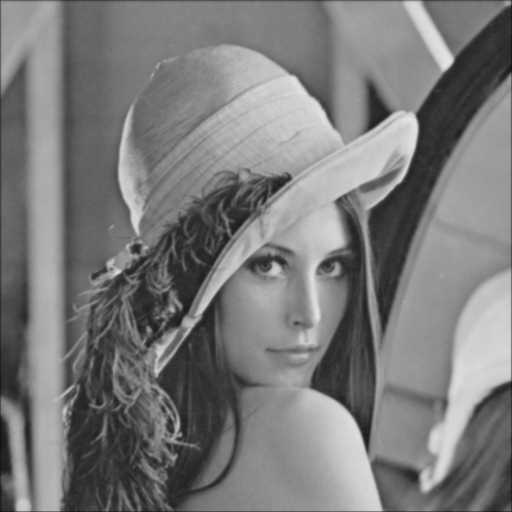

In [71]:
rows, cols = imgt.shape
for l in range (1,rows-1):
  for c in range (1,cols-1):
    imgt[l,c]=(imgt[l-1,c-1].astype(np.int16)+imgt[l-1,c].astype(np.int16)+imgt[l-1,c+1].astype(np.int16)+
              imgt[l,c-1].astype(np.int16)+imgt[l,c].astype(np.int16)+imgt[l,c+1].astype(np.int16)+
              imgt[l+1,c-1].astype(np.int16)+imgt[l+1,c].astype(np.int16)+imgt[l+1,c+1].astype(np.int16))/9
img=imgt[1:-1,1:-1]
print(img.shape)
cv2_imshow(img)

## **FILTROS PARA BLURRING**

O filtro de **blurring (borramento)** consiste na  perda gradual de foco da imagem, produzindo a sensação que ela está borrada. 

Existem diversos métodos para construções de kernels para blurring:


*   **filtro da média (box filter)**: blur = cv.blur(img,(5,5))
*   **filtro gaussiano**: blur = cv.GaussianBlur(img,(5,5),0)
*   **filtro da mediana**: blur = cv.medianBlur(img,5)
*   **filtro bilateral**: blur = cv.bilateralFilter(img,9,75,75)

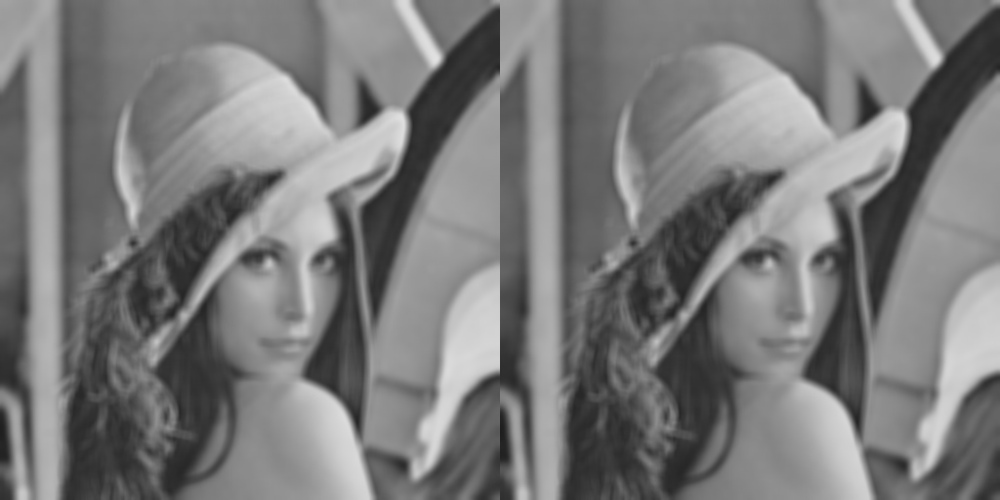

In [72]:
#implementação dos filtros

img = cv.imread('lena.png',0)
blur=cv.blur(img,(9,9))
gauss=cv.GaussianBlur(img,(9,9),40)
cv2_imshow(np.hstack((blur,gauss)))

Reaplicando os dois filtros na imagem lena.jpg, porém agora usando um produto de convolução diretamente com os kernels.

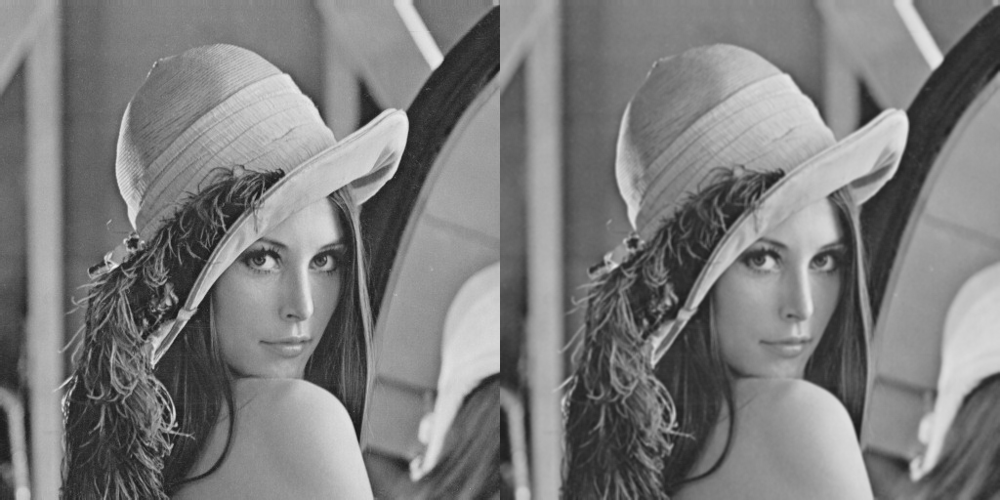

In [74]:
img = cv.imread('lena.png')
img = cv.cvtColor(cv.imread('lena.png'), cv.COLOR_BGR2GRAY)

blur =np.array([[1/9,1/9,1/9],
                [1/9,1/9,1/9],
                [1/9,1/9,1/9]])
imgf = cv.filter2D(img,-1,blur)
cv2_imshow(np.hstack((img,imgf)))

Uma das aplicações importantes dos filtros de blurring consiste na atenuação de ruído (noise) em imagens. Considerando a imagem com ruído abaixo, verifique quais dos filtros anteriores consegue atenuar de maneira mais efetiva o ruído.

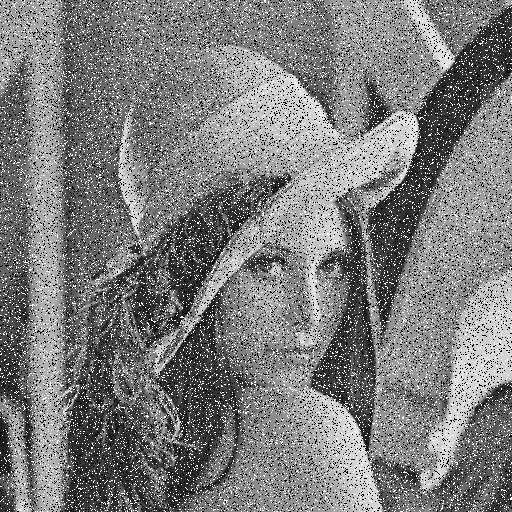

In [75]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
import random

def sp_noise(image,prob):
    '''
    Add salt and pepper noise to image
    prob: Probability of the noise
    '''
    output = np.zeros(image.shape,np.uint8)
    thres = 1 - prob 
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            rdn = random.random()
            if rdn < prob:
                output[i][j] = 0
            elif rdn > thres:
                output[i][j] = 255
            else:
                output[i][j] = image[i][j]
    return output

img = cv.imread('lena.png',0)
img=sp_noise(img,0.1)
cv2_imshow(img)

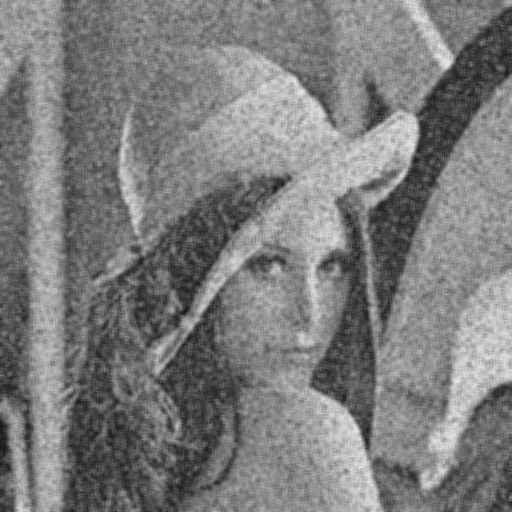

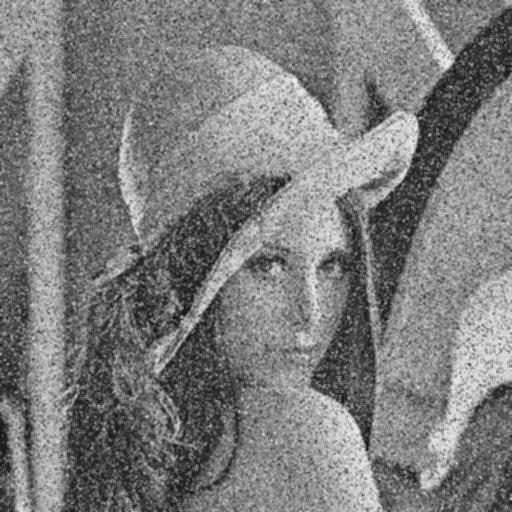

In [78]:
cv2_imshow(cv.blur(img,(5,5)))

blur2 =np.array([[1/9,1/9,1/9],
                [1/9,1/9,1/9],
                [1/9,1/9,1/9]])
imgf = cv.filter2D(img,-1,blur2)
cv2_imshow(imgf)

## **FILTRO DE SHARPENING**

Aproximação da inversa do filtro de blurring.

Implementando o filtro de sharpening através de um produto de convolução em OpenCV:

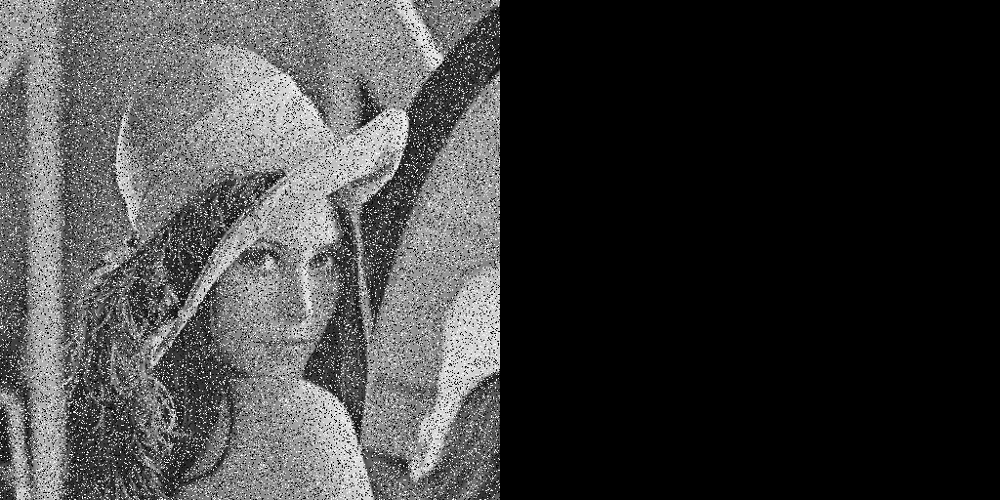

In [80]:
img = cv.imread('lena.png',0)
img=sp_noise(img,0.1)


blur=cv.blur(img,(5,5))



kernel =np.array([[0,-6,0],
                [-6,15,-6],
                [0,-6,0]])

imgf = cv.filter2D(blur,-1,kernel)
cv2_imshow(np.hstack((img,imgf)))